# Bias Mitigation Experiments - COMPAS

## Table of Contents

<!-- To return to the table of contents, click on the number at any major section heading.

* [1. Prepare COMPAS data](#1.-Prepare-COMPAS-data)

* [2. Training Baseline Models](#2.-Training-Baseline-Models)
    * [2.1 Logistic Regression](#2.1-Learning-a-Logistic-Regression-(LR)-classifier-on-original-data)
    * [2.2 Random Forest](#2.2-Learning-a-Random-Forest-(RF)-classifier-on-original-data)

* [3. Bias mitigation using pre-processing technique](#3.-Bias-mitigation-using-pre-processing-technique)

   * [3.1 Reweighing](#3.1-Reweighing)
       * [3.1.1 RW on Logistic Regression](#3.1.1.-Learning-a-Logistic-Regression-(LR)-classifier-on-data-transformed-by-reweighing)
       * [3.1.2 RW on Random Forest](#3.1.2.-Learning-a-Random-Forest-(RF)-classifier-on-data-transformed-by-reweighing)
   * [3.2 Disparate impact remover ](#3.2-Disparate-impact-remover)
       * [3.2.1 DIR on Logistic Regression](#3.2.1-Learning-a-Logistic-Regression-(LR)-classifier-on-data-transformed-by-DIR)
       * [3.2.2 DIR on Random Forest](#3.2.2-Learning-a-Random-Forest-(RF)-classifier-on-data-transformed-by-DIR)
  
* [4. Bias mitigation using in-processing technique](#4.-Bias-mitigation-using-in-processing-technique)
    * [4.1 Prejudice Remover (PR)](#4.1-Prejudice-Remover-(PR))
    * [4.2 Adversarial Debiasing](#4.2-Adversarial-Debiasing)

* [5. Bias mitigation using post-processing technique](#5.-Bias-mitigation-using-post-processing-technique)
    * [5.1 Reject option classification (ROC)](#5.1-Reject-option-classification-(RejOpCl))
        * [5.1.1 ROC on Logistic Regression](#5.1.1-Reject-option-classification-on-Logistic-Regression)
        * [5.1.2 ROC on Random Forest](#5.1.2-Reject-option-classification-on-Random-Forest)
    * [5.2 Equalized odds processor (EOPP)](#5.2-Equalized-odds-processor-(EqOddsPr))
        * [5.2.1 EOPP on Logistic Regression](#5.2.1-Equalized-odds-processor-on-Logistic-Regression)
        * [5.2.2 EOPP on Random Forest](#5.2.2-Equalized-odds-processor-on-Random-Forest)

* [6. Summary of results](#6.-Summary-of-Model-Learning-Results)

* [7. Analyze rates of different mitigators](#7.-Analyze-rates-of-different-mitigators)

 -->

In [1]:
# to ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
import helperfunctions as helpers
%load_ext autoreload
%autoreload 2
# allow automatic reloading of changes in helperfile

In [3]:
# Standard packages
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
import tensorflow.compat.v1 as tf
# tf.disable_eager_execution()
tf.logging.set_verbosity(tf.logging.ERROR)
import seaborn as sns
import random
from tqdm import tqdm
from numpy import mean
from numpy import std
from IPython.display import Markdown, display

# Plotting 
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

# Sklearn
# from sklearn.cluster import KMeans
# from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_transformer
from sklearn.model_selection import GridSearchCV, train_test_split, ParameterGrid
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import StratifiedKFold
## accuracy metrics
from sklearn.metrics import accuracy_score, balanced_accuracy_score, f1_score, roc_auc_score, matthews_corrcoef
from sklearn.metrics import recall_score, precision_score # for fairness metrics (calculate diff)
## base estimators
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB

# Fairness metrics
from aif360.metrics import BinaryLabelDatasetMetric
from aif360.metrics import ClassificationMetric
from aif360.sklearn.metrics import difference as aif_difference
# from aif360.sklearn.metrics import specificity_score, false_omission_rate_error
from aif360.sklearn.metrics import specificity_score
from aif360.sklearn.metrics import statistical_parity_difference, average_odds_difference, \
                                   equal_opportunity_difference, average_odds_error
from aif360.sklearn.metrics import consistency_score, generalized_entropy_index, theil_index

# Explainers
from aif360.explainers import MetricTextExplainer

# Scalers
from sklearn.preprocessing import StandardScaler

# Classifiers
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline

# Bias mitigation techniques
# from aif360.algorithms.preprocessing import Reweighing
# from aif360.algorithms.preprocessing import OptimPreproc
# from aif360.algorithms.preprocessing import DisparateImpactRemover
# from aif360.algorithms.preprocessing import LFR
from aif360.sklearn.preprocessing import Reweighing, ReweighingMeta, LearnedFairRepresentations
from aif360.sklearn.inprocessing import AdversarialDebiasing, ExponentiatedGradientReduction
from aif360.sklearn.postprocessing import CalibratedEqualizedOdds, RejectOptionClassifier


# Set plot font
plt.rcParams.update({'font.family':'serif'})
plt.rcParams.update({'font.serif':'Times New Roman'})

2023-02-02 01:56:14.554034: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-02-02 01:56:14.554066: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
pip install 'aif360[LawSchoolGPA]'
pip install 'aif360[FairAdapt]'


In [4]:
import math
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, average_precision_score, accuracy_score
from tensorflow.keras.callbacks import EarlyStopping

from tabtransformertf.models.tabtransformer import TabTransformer
from tabtransformertf.utils.preprocessing import df_to_dataset, build_categorical_prep

In [5]:
# set seed to reproduce code for TabTransformer
random_state = 1234
tf.random.set_seed(random_state)
from numpy.random import seed
seed(random_state)

## [1.](#Table-of-Contents) Prepare COMPAS data

In [6]:
# read in data as pandas data frame
df = pd.read_csv("../data/Compas/compas-scores-two-years.csv")
# check columns
pd.set_option('display.max_columns', None) # expand all columns
df.head()

,id,name,first,last,compas_screening_date,sex,dob,age,age_cat,race,juv_fel_count,decile_score,juv_misd_count,juv_other_count,priors_count,days_b_screening_arrest,c_jail_in,c_jail_out,c_case_number,c_offense_date,c_arrest_date,c_days_from_compas,c_charge_degree,c_charge_desc,is_recid,r_case_number,r_charge_degree,r_days_from_arrest,r_offense_date,r_charge_desc,r_jail_in,r_jail_out,violent_recid,is_violent_recid,vr_case_number,vr_charge_degree,vr_offense_date,vr_charge_desc,type_of_assessment,decile_score.1,score_text,screening_date,v_type_of_assessment,v_decile_score,v_score_text,v_screening_date,in_custody,out_custody,priors_count.1,start,end,event,two_year_recid
0,1,miguel hernandez,miguel,hernandez,2013-08-14,Male,1947-04-18,69,Greater than 45,Other,0,1,0,0,0,-1.0,2013-08-13 06:03:42,2013-08-14 05:41:20,13011352CF10A,2013-08-13,NaN,1.0,F,Aggravated Assault w/Firearm,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,1,Low,2013-08-14,Risk of Violence,1,Low,2013-08-14,2014-07-07,2014-07-14,0,0,327,0,0
1,3,kevon dixon,kevon,dixon,2013-01-27,Male,1982-01-22,34,25 - 45,African-American,0,3,0,0,0,-1.0,2013-01-26 03:45:27,2013-02-05 05:36:53,13001275CF10A,2013-01-26,NaN,1.0,F,Felony Battery w/Prior Convict,1,13009779CF10A,(F3),NaN,2013-07-05,Felony Battery (Dom Strang),NaN,NaN,NaN,1,13009779CF10A,(F3),2013-07-05,Felony Battery (Dom Strang),Risk of Recidivism,3,Low,2013-01-27,Risk of Violence,1,Low,2013-01-27,2013-01-26,2013-02-05,0,9,159,1,1
2,4,ed philo,ed,philo,2013-04-14,Male,1991-05-14,24,Less than 25,African-American,0,4,0,1,4,-1.0,2013-04-13 04:58:34,2013-04-14 07:02:04,13005330CF10A,2013-04-13,NaN,1.0,F,Possession of Cocaine,1,13011511MM10A,(M1),0.0,2013-06-16,Driving Under The Influence,2013-06-16,2013-06-16,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,4,Low,2013-04-14,Risk of Violence,3,Low,2013-04-14,2013-06-16,2013-06-16,4,0,63,0,1
3,5,marcu brown,marcu,brown,2013-01-13,Male,1993-01-21,23,Less than 25,African-American,0,8,1,0,1,NaN,NaN,NaN,13000570CF10A,2013-01-12,NaN,1.0,F,Possession of Cannabis,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,8,High,2013-01-13,Risk of Violence,6,Medium,2013-01-13,NaN,NaN,1,0,1174,0,0
4,6,bouthy pierrelouis,bouthy,pierrelouis,2013-03-26,Male,1973-01-22,43,25 - 45,Other,0,1,0,0,2,NaN,NaN,NaN,12014130CF10A,NaN,2013-01-09,76.0,F,arrest case no charge,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,Risk of Recidivism,1,Low,2013-03-26,Risk of Violence,1,Low,2013-03-26,NaN,NaN,2,0,1102,0,0


In [7]:
# select features of interest
df = df[['sex','age','race','juv_fel_count','juv_misd_count','juv_other_count','priors_count','c_charge_degree', 'two_year_recid']]

# unique values of the protected feature race
df['race'].value_counts()

African-American    3696
Caucasian           2454
Hispanic             637
Other                377
Asian                 32
Native American       18
Name: race, dtype: int64

In [8]:
# encode protected features 

# make race (=protected attribute) a binary variable
array = ['Caucasian', 'African-American'] # only include samples corresponding to Caucasian or African-American
df = df.loc[df['race'].isin(array)]

def protected_race(row):
    if row['race'] == 'Caucasian': # Caucasian is the privileged group in this case
        value = 1
    else:
        value = 0
    return value

df['race'] = df.apply(protected_race, axis=1)

# make sex a binary variable
def protected_sex(row):
    if row['sex'] == 'Female': # female is the privileged group in this case
        value = 1
    else:
        value = 0
    return value

df['sex'] = df.apply(protected_sex, axis=1)

In [9]:
# # one hot encoding of object features
# categorical_cols = list(df.select_dtypes(exclude=[np.number]).columns)
# df = pd.get_dummies(df, columns = categorical_cols)

# # encode binary feature: c_charge 
# df = df.drop(['c_charge_degree_F'], axis=1)
# reset index
df = df.reset_index(drop=True)

In [10]:
# flip labels to ensure pos_label = 1, not becoming recidivist
df['two_year_recid'] = (~df['two_year_recid'].astype(bool)).astype(int)

# select descriptive features and target variable
X = df.loc[:, df.columns != 'two_year_recid'] # select all features but target feature
y = df[['race', 'two_year_recid']] # include protected feature in order to AIF360

In [11]:
# set protected attribute as index
X = X.set_index(['race'], append = True, drop = False)
y = y.set_index(['race'], append = True)

# make y data frames to 1d array to pass modeling, but keep index (protected attribute)
y = pd.Series(y['two_year_recid'], index=y.index)

In [12]:
pos_label = 1
priv_group = 1

In [13]:
# X.to_pickle('COMPAS_X')
# y.to_pickle('COMPAS_y')

## [2.](#Table-of-Contents) Proposed GridSearch Approach 

The GridSearch Approach includes hyperparameter, threshold, and Bias Mitigation

In [14]:
# taken from AIF360/aif360/sklearn/metrics/metrics.py due to import error
from sklearn.metrics._classification import _prf_divide, _check_zero_division
from sklearn.metrics import multilabel_confusion_matrix
def false_omission_rate_error(y_true, y_pred, *, pos_label=1, sample_weight=None,
                      zero_division='warn'):
    """Compute the false omission rate.
    Args:
        y_true (array-like): Ground truth (correct) target values.
        y_pred (array-like): Estimated targets as returned by a classifier.
        pos_label (scalar, optional): The label of the positive class.
        sample_weight (array-like, optional): Sample weights.
        zero_division ('warn', 0 or 1): Sets the value to return when there is a
            zero division. If set to “warn”, this acts as 0, but warnings are
            also raised.
    """
    _check_zero_division(zero_division)
    MCM = multilabel_confusion_matrix(y_true, y_pred, labels=[pos_label],
                                      sample_weight=sample_weight)
    tn, fn = MCM[:, 0, 0], MCM[:, 1, 0]
    negs = tn + fn
    return _prf_divide(fn, negs, 'false omission rate', 'predicted negative', None,
                       ('false omission rate',), zero_division).item()

In [15]:
accuracy_metrics = ['acc_score', 'bacc_score', 'f1_score', 'auc_score', 'mcc_score','norm_mcc_score']
group_fairness = ['spd_score', 'aod_score', 'eod_score','ford_score','ppvd_score']
individual_fairness = ['consistency_score','gei_score','ti_score']
fairness_metrics = group_fairness+individual_fairness

# bm_category = {'None':'None', 'RW':'pre', 'LFR_pre':'pre',
#                'LFR_in':'in', 'AD':'in', 'EGR':'in',
#                'ROC':'post', 'CEO':'post'}

bm_category = {'PRE':['RW', 'LFR_pre'],
               'IN': ['LFR_in','AD','EGR'],
               'POST':['ROC','CEO']}

def store_metrics(y_test, y_pred, X_test, pred_prob, thres_dict, BM_name, threshold, priv_group, pos_label):
    """Returns a dictionary with all interested accuracy and fairness metrics.
        Args:
            y_test (array-like): true labels from test set.
            y_pred (array-like): predicted labels for test set.
            thres_dict (dict): dictionary that stores all info.
            threshold (np.float): given threshold used to obtain y_pred.
        Returns:
            dict: `thres_dict`
    """
    # evaluate model performance for each split
    # --------------------------------------- Accuracy Metrics ---------------------------------------
    thres_dict[BM_name][threshold]['acc_score'] += [accuracy_score(y_test, y_pred)]
    thres_dict[BM_name][threshold]['bacc_score'] += [balanced_accuracy_score(y_test, y_pred)]
    thres_dict[BM_name][threshold]['f1_score'] += [f1_score(y_test, y_pred)]
    thres_dict[BM_name][threshold]['auc_score'] += [roc_auc_score(y_test, pred_prob)]
    thres_dict[BM_name][threshold]['mcc_score'] += [matthews_corrcoef(y_test, y_pred)]
    thres_dict[BM_name][threshold]['norm_mcc_score'] += [0.5*(matthews_corrcoef(y_test, y_pred)+1)]
    # ------------------------------------- Group Fairness Metrics ------------------------------------
    thres_dict[BM_name][threshold]['spd_score'] += [statistical_parity_difference(y_test, y_pred, prot_attr='race',
                                                                                  priv_group=priv_group, pos_label=pos_label)]
    thres_dict[BM_name][threshold]['aod_score'] += [average_odds_difference(y_test, y_pred, prot_attr='race',
                                                                            priv_group=priv_group, pos_label=pos_label)]
    thres_dict[BM_name][threshold]['eod_score'] += [equal_opportunity_difference(y_test, y_pred, prot_attr='race',
                                                                                 priv_group=priv_group, pos_label=pos_label)]
    thres_dict[BM_name][threshold]['ford_score'] += [aif_difference(false_omission_rate_error, y_test, y_pred,
                                                                    prot_attr='race', priv_group=priv_group, pos_label=pos_label)]
    thres_dict[BM_name][threshold]['ppvd_score'] += [aif_difference(precision_score, y_test, y_pred, prot_attr='race',
                                                                    priv_group=priv_group, pos_label=pos_label)]
    # ---------------------------------- Individual Fairness Metrics ----------------------------------
    thres_dict[BM_name][threshold]['consistency_score'] += [consistency_score(X_test, y_pred)]
    thres_dict[BM_name][threshold]['gei_score'] += [generalized_entropy_index(b=y_pred-y_test+1)] # ref: speicher_unified_2018
    thres_dict[BM_name][threshold]['ti_score'] += [theil_index(b=y_pred-y_test+1)]

    return thres_dict

def get_avg_metrics(thres_dict):
    """Returns the average of all cv splits from the same model setting (hyperparameter and threshold).
    Args:
        thres_dict (dict): the dictionary with all info on each cv split.
    Returns:
        dict: `final_metrics`
    """ 
    import copy
    # calculate the average for each metrics from all splits
    avg_metrics = copy.deepcopy(thres_dict)
    for BM in avg_metrics.keys():
        for threshold in avg_metrics[BM].keys(): 
            average_list = {}
            for metric in avg_metrics[BM][threshold].keys():
                average_list['avg_%s'%metric] = mean(avg_metrics[BM][threshold][metric])
            avg_metrics[BM][threshold]['average'] = average_list
    return avg_metrics

def get_output_table(all_metrics, base, scoring):
    """Returns the output table from all param_grid.
    Args:
        all_metrics (dict): the final dictionary with info from all param_grid.
        base (str): the name of the base estimator that is shown in the output table.
    """ 

    output_table = pd.DataFrame()
    for model in all_metrics.keys():
        all_metrics[model]['parameters']['hparam'].pop('random_state', None)
        table_cv = pd.DataFrame(all_metrics[model]['metrics']['average'], index=[0])
        table_cv.insert(0, 'base_estimator', base)
        table_cv.insert(1, 'param', str(all_metrics[model]['parameters']['hparam']))
        table_cv.insert(2, 'Bias_Mitigation', str(all_metrics[model]['parameters']['Bias_Mitigation']))
        table_cv.insert(3, 'threshold', all_metrics[model]['parameters']['threshold'])
        # table_cv[['base_estimator','param']] = np.where(table_cv['Bias_Mitigation'].isin(bm_category['IN'])&\
        #                                                 (table_cv['Bias_Mitigation']!='EGR'), 
        #                                                 '', table_cv[['base_estimator','param']])
        output_table = pd.concat([output_table, table_cv]).reset_index(drop=True)
    
    # find "best" model
    acc_metric = 'avg_'+scoring[0].lower()+'_score'
    fair_metric = 'avg_'+scoring[1].lower()+'_score'
    w_acc = scoring[2]
    w_fair = scoring[3]
    acc_cost = 1-output_table[acc_metric]
    fair_cost = output_table[fair_metric]

    output_table['cost'] = w_acc*acc_cost + w_fair*fair_cost
    return output_table

def style_table(df):
    """Returs the output table with highlight on the best metrics
    Args:
        df (DataFrame): the output table to be styled
    """
    avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
    avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]

    best_index = np.argmin(df.cost)
    df = df.style.highlight_max(subset=avg_accuracy_metrics,color='lightgreen')\
                   .apply(lambda s:['background: yellow' if abs(cell)==min(abs(s)) else '' for cell in s],
                          subset=avg_fairness_metrics)\
                   .highlight_min(subset=['cost'],color='lightblue')\
                   .apply(lambda s:['font-weight: bold' if v == s.iloc[best_index] else '' for v in s])
    
    return df

def merge_dictionary_list(dict_list):
    result_dict = {}
    for d in dict_list:
        for BM in d:
            if BM not in result_dict:
                result_dict[BM] = {}
            for thres in d[BM]:
                if thres not in result_dict[BM]:
                    result_dict[BM][thres] = {}
                for metric in d[BM][thres]:
                    if metric not in result_dict[BM][thres]:
                        result_dict[BM][thres][metric] = []
                    result_dict[BM][thres][metric].append(d[BM][thres][metric].pop())

    return result_dict


In [16]:
def get_num_cat_col(X_train, X_test, y_train , y_test):
    LABEL = y_train.name
    train_data = pd.concat([X_train,y_train], axis=1)
    try: test_data = pd.concat([X_test, y_test], axis=1)
    except: pass
    NUMERIC_FEATURES = train_data.drop(LABEL, axis=1).select_dtypes(include=np.number).columns
    CATEGORICAL_FEATURES = train_data.drop(LABEL, axis=1).select_dtypes(exclude=np.number).columns
    
    return train_data, test_data, NUMERIC_FEATURES, CATEGORICAL_FEATURES
    
def tf_dataset_for_TrainValTest(train_data, test_data, CATEGORICAL_FEATURES, NUMERIC_FEATURES):
    LABEL = train_data.columns[-1]
    FEATURES = list(NUMERIC_FEATURES) + list(CATEGORICAL_FEATURES)
    # format dataset
    for dataset in [train_data, test_data]:
        dataset[LABEL] = dataset[LABEL].apply(lambda x: int(x)) 
        dataset[CATEGORICAL_FEATURES] = dataset[CATEGORICAL_FEATURES].astype(str)
        dataset[NUMERIC_FEATURES] = dataset[NUMERIC_FEATURES].astype(float)
    # Train/val split
    train, val = train_test_split(train_data, test_size=0.2, random_state=random_state)
    # Category preprocessing layers
    category_prep_layers = build_categorical_prep(train, CATEGORICAL_FEATURES)
    # To TF Dataset
    train_dataset = df_to_dataset(train[FEATURES + [LABEL]], LABEL)
    val_dataset = df_to_dataset(val[FEATURES + [LABEL]], LABEL, shuffle=False)  # No shuffle
    test_dataset = df_to_dataset(test_data[FEATURES], shuffle=False) # No target, no shuffle
    
    return train, val, train_dataset, val_dataset, test_dataset


In [17]:
# class skf_model():
#     """
#     stratified k-fold model class, to implement the grid-search framework 
#     with k-fold to ensure performance stability.
#     """
#     def __init__(self, pos_label, priv_group, cv, random_state, n_jobs):
#         self.pos_label = pos_label
#         self.priv_group = priv_group
#         self.cv = cv
#         self.random_state = random_state
#         self.n_jobs = n_jobs
        
#     # @methods
#     def get_metrics(self, X, y, base='LR', param = {}, BM_arr=[None], thres_arr=[0.5]):
#         # train classifier with stratified kfold cross validation
#         skf = StratifiedKFold(n_splits=self.cv, shuffle=True, random_state=self.random_state)
#         import copy
#         all_metrics_dict = {metric:[] for metric in accuracy_metrics+fairness_metrics}
#         thres_dict = {str(BM): {threshold: copy.deepcopy(all_metrics_dict) for threshold in thres_arr} for BM in BM_arr}
#         # thres_dict = {threshold: {'acc_score':[], 'bacc_score': [], 'f1_score': [], 'auc_score': [],
#         #                           'mcc_score': [],'norm_mcc_score': [],
#         #                           'spd_score': [], 'aod_score': [], 'eod_score': [],'ford_score': [],'ppvd_score': [],
#         #                           'consistency_score': [], 'gei_score': [], 'ti_score': []}\
#         #               for threshold in thres_arr}
#         thres_BM_dict = {}
        
#         for train_index, test_index in skf.split(X, y):
#             categorical_cols = list(X.select_dtypes(exclude=[np.number]).columns)
#             X = pd.get_dummies(X, columns = categorical_cols)

#             X_train, X_test = X.iloc[train_index,:],X.iloc[test_index,:]
#             y_train , y_test = y[train_index] , y[test_index]

#             # normalize data features, fit only on training data to avoid data leakage
#             scaler = StandardScaler()
#             scaler.fit(X_train[X_train.columns])
#             X_train[X_train.columns] = scaler.transform(X_train[X_train.columns])
#             X_test[X_test.columns] = scaler.transform(X_test[X_test.columns])

#             # assign base estimator
#             if base!='NB':
#                 param.update({'random_state': self.random_state})
#             else: pass
        
#             if base=='LR':
#                 base_estimator=LogisticRegression(**param)
#             elif base=='RF':
#                 base_estimator=RandomForestClassifier(**param)
#             elif base=='GB':
#                 base_estimator=GradientBoostingClassifier(**param)
#             elif base=='SVM':
#                 param.update({'probability':True})
#                 base_estimator=SVC(**param)
#             elif base=='NB':
#                 base_estimator=GaussianNB(**param)
 
#             # assign bias mitigation
#             BM_dict = {None: base_estimator, 
#                        # pre-processing
#                        'RW': ReweighingMeta(estimator=base_estimator), 
#                        'LFR_pre': LearnedFairRepresentations(prot_attr='race', random_state=self.random_state),
#                        # in-processing
#                        'LFR_in': LearnedFairRepresentations(prot_attr='race', random_state=self.random_state),
#                        'AD': AdversarialDebiasing(prot_attr='race', random_state=self.random_state),
#                        'EGR': ExponentiatedGradientReduction(prot_attr='race', estimator=base_estimator,
#                                                              constraints="EqualizedOdds"),
#                        # post-processing
#                        'ROC': base_estimator,
#                        'CEO': base_estimator} 
    
#             for BM in BM_arr:
#                 BM_name = str(BM)
#                 model = BM_dict[BM]
#                 # fit
#                 if BM=='LFR_pre':
#                     model.fit(X_train, y_train, priv_group=self.priv_group)
#                     base_estimator.fit(model.transform(X_train), y_train)
#                     model = base_estimator # but now the base estimator is fit on lfr transformed training data
#                 elif BM=='LFR_in':
#                     model.fit(X_train,y_train,priv_group=self.priv_group)
#                 else: model.fit(X_train,y_train)

#                 # predict
#                 pred_prob_all = model.predict_proba(X_test)
#                 pred_prob = pred_prob_all[:,1]

#                 for threshold in thres_arr:
#                     y_pred = (pred_prob >= threshold).astype('int') # set threshold
#                     if BM not in bm_category['POST']:
#                         thres_dict = store_metrics(y_test, y_pred, X_test, pred_prob, thres_dict, BM_name, threshold,
#                                                    self.priv_group, self.pos_label)
#                     else: # Post-Processing
#                         if BM=='ROC':
#                             # fit the primary prediction to post-processing models  
#                             post_model = RejectOptionClassifier(prot_attr='race',threshold=threshold)
#                             post_model.fit(pred_prob_all,y_test,pos_label=self.pos_label,priv_group=self.priv_group)
#                         elif BM=='CEO':
#                             post_model = CalibratedEqualizedOdds(prot_attr='race',random_state=self.random_state)
#                             post_model.fit(pred_prob_all,y_test,pos_label=self.pos_label)                            
#                         # get final prediction
#                         initial_pred = pd.DataFrame(pred_prob_all, index=X_test.index)
#                         final_pred_prob = post_model.predict_proba(initial_pred)[:,1]
#                         final_y_pred = (final_pred_prob >= threshold).astype('int') # set threshold
#                         thres_dict = store_metrics(y_test, final_y_pred, X_test, final_pred_prob, thres_dict, BM_name, threshold,
#                                                    self.priv_group, self.pos_label)
#                 avg_metrics = get_avg_metrics(thres_dict)
#                 # thres_BM_dict[BM_name] = avg_metrics
#                 thres_BM_dict.update(avg_metrics)

#         return thres_BM_dict

In [18]:
# from sklearn.utils.parallel import delayed, Parallel
import multiprocessing #original multiprocessing
import multiprocess as mp #better multiprocessing for python
from itertools import repeat

from multiprocessing import set_start_method
set_start_method("spawn")

from multiprocessing import get_context

In [19]:
# cv = 5
# random_state = 1234
# skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=random_state)

# # for train_index, test_index in skf.split(X, y):
# def prepare_train_test(X, y, train_index, test_index):
#     X_train, X_test = X.iloc[train_index,:],X.iloc[test_index,:]
#     y_train , y_test = y[train_index] , y[test_index]

#     return X_train, y_train, X_test, y_test

# i=0
# X_train, y_train, X_test, y_test = prepare_train_test(X, y, list(skf.split(X, y))[i][0], list(skf.split(X, y))[i][1])

In [20]:
# X = pd.read_pickle('COMPAS_X')
# y = pd.read_pickle('COMPAS_y')
# data = pd.concat([X,y], axis=1)
# # .reset_index(drop=True)
# train_data, test_data = train_test_split(data, test_size=0.2, random_state=random_state)
# train_data.head()

# target_var = 'two_year_recid'
# X_train, y_train = train_data.drop(target_var, axis=1), train_data[target_var]
# X_test, y_test = test_data.drop(target_var, axis=1), test_data[target_var]

In [21]:
# LABEL = y.name
# # X_train, X_test = X.iloc[train_index,:],X.iloc[test_index,:]
# # y_train , y_test = y[train_index] , y[test_index]
# train_data,test_data,NUMERIC_FEATURES,CATEGORICAL_FEATURES = get_num_cat_col(X_train,X_test,y_train,y_test)
# train, val, train_dataset, val_dataset, test_dataset = tf_dataset_for_TrainValTest(train_data, test_data,
#                                                                                    CATEGORICAL_FEATURES, NUMERIC_FEATURES)
# category_prep_layers = build_categorical_prep(train, CATEGORICAL_FEATURES)

# tabtransformer = TabTransformer(
#     numerical_features = NUMERIC_FEATURES,
#     categorical_features = CATEGORICAL_FEATURES,
#     categorical_lookup=category_prep_layers,
#     embedding_dim=32,
#     out_dim=1,
#     out_activation='sigmoid',
#     depth=4,
#     heads=8,
#     attn_dropout=0.2,
#     ff_dropout=0.2,
#     mlp_hidden_factors=[2, 4],
#     use_column_embedding=True,
# )

In [22]:
# LEARNING_RATE = 0.0001
# WEIGHT_DECAY = 0.0001
# NUM_EPOCHS = 3

# optimizer = tfa.optimizers.AdamW(learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY)
# print('optimizer')
# tabtransformer.compile(optimizer = optimizer,
#                        loss = tf.keras.losses.BinaryCrossentropy(),
#                        metrics= [tf.keras.metrics.AUC(name="PR AUC", curve='PR')],)
# print('start')
# early = EarlyStopping(monitor="val_loss", mode="min", patience=10, restore_best_weights=True)
# callback_list = [early]
# print('callback_list')


In [23]:
# early = EarlyStopping(monitor="val_loss", mode="min", patience=10, restore_best_weights=True)
# callback_list = [early]

# history = tabtransformer.fit(
#     train_dataset, 
#     epochs=NUM_EPOCHS, 
#     validation_data=val_dataset,
#     callbacks=callback_list
# )

In [24]:
# test_preds = tabtransformer.predict(test_dataset)
# test_preds

In [37]:
class skf_model():
    """
    stratified k-fold model class, to implement the grid-search framework 
    with k-fold to ensure performance stability.
    """
    def __init__(self, pos_label, priv_group, cv, random_state, n_jobs):
        self.pos_label = pos_label
        self.priv_group = priv_group
        self.cv = cv
        self.random_state = random_state
        self.n_jobs = n_jobs
        
    def run_search(self, train_index, test_index, X, y, base, param, BM_arr, thres_arr, thres_dict):
        if base=='TabTrans':
            LABEL = y.name
            X_train, X_test = X.iloc[train_index,:],X.iloc[test_index,:]
            y_train , y_test = y[train_index] , y[test_index]
            train_data,test_data,NUMERIC_FEATURES,CATEGORICAL_FEATURES = get_num_cat_col(X_train,X_test,y_train,y_test)
            train, val, train_dataset, val_dataset, test_dataset = tf_dataset_for_TrainValTest(train_data, test_data,
                                                                                               CATEGORICAL_FEATURES, NUMERIC_FEATURES)
            category_prep_layers = build_categorical_prep(train, CATEGORICAL_FEATURES)
        else:
            categorical_cols = list(X.select_dtypes(exclude=[np.number]).columns)
            X = pd.get_dummies(X, columns = categorical_cols)

            X_train, X_test = X.iloc[train_index,:],X.iloc[test_index,:]
            y_train , y_test = y[train_index] , y[test_index]

            # normalize data features, fit only on training data to avoid data leakage
            scaler = StandardScaler()
            scaler.fit(X_train[X_train.columns])
            X_train[X_train.columns] = scaler.transform(X_train[X_train.columns])
            X_test[X_test.columns] = scaler.transform(X_test[X_test.columns])

            
        # assign base estimator
        if base!='NB':
            param.update({'random_state': self.random_state})
        else: pass

        if base=='LR':
            base_estimator=LogisticRegression(**param)
        elif base=='RF':
            base_estimator=RandomForestClassifier(**param)
        elif base=='GB':
            base_estimator=GradientBoostingClassifier(**param)
        elif base=='SVM':
            param.update({'probability':True})
            base_estimator=SVC(**param)
        elif base=='NB':
            base_estimator=GaussianNB(**param)
        elif base=='TabTrans':
            base_estimator=TabTransformer(numerical_features = NUMERIC_FEATURES,
                                          categorical_features = CATEGORICAL_FEATURES,
                                          categorical_lookup=category_prep_layers,
                                          embedding_dim=32,
                                          out_dim=1,
                                          out_activation='sigmoid',
                                          depth=4,
                                          heads=8,
                                          attn_dropout=0.2,
                                          ff_dropout=0.2,
                                          mlp_hidden_factors=[2, 4],
                                          use_column_embedding=True)
            LEARNING_RATE = 0.0001
            WEIGHT_DECAY = 0.0001
            NUM_EPOCHS = 30

            optimizer = tfa.optimizers.AdamW(learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY)
            base_estimator.compile(optimizer = optimizer,
                                   loss = tf.keras.losses.BinaryCrossentropy(),
                                   metrics= [tf.keras.metrics.AUC(name="PR AUC", curve='PR')],)
            early = EarlyStopping(monitor="val_loss", mode="min", patience=10, restore_best_weights=True)
            callback_list = [early]

        # assign bias mitigation
        BM_dict = {None: base_estimator, 
                   # pre-processing
                   # 'RW': ReweighingMeta(estimator=base_estimator), 
                   'RW': Reweighing(prot_attr='race'), 
                   'LFR_pre': LearnedFairRepresentations(prot_attr='race', random_state=self.random_state),
                   # in-processing
                   'LFR_in': LearnedFairRepresentations(prot_attr='race', random_state=self.random_state),
                   'AD': AdversarialDebiasing(prot_attr='race', random_state=self.random_state),
                   'EGR': ExponentiatedGradientReduction(prot_attr='race', estimator=base_estimator,
                                                         constraints="EqualizedOdds"),
                   # post-processing
                   'ROC': base_estimator,
                   'CEO': base_estimator} 

        for BM in BM_arr:
            BM_name = str(BM)
            model = BM_dict[BM]
            # fit
            # print('start fitting...')
            if BM=='RW':
                print('RW')
                # model.fit(X_train, y_train)
                sample_weight = None 
                if base!='TabTrans': 
                    X_train, sample_weight = model.fit_transform(X_train, y_train, sample_weight)
                    base_estimator.fit(X_train, y_train, sample_weight)
                else: 
                    print('start')
                    # first reweigh training and validating data
                    train_idx, val_idx = train.index, val.index
                    tmp_data = pd.concat([train, val])
                    tmp_data, sample_weight = model.fit_transform(tmp_data.drop(LABEL, axis=1),
                                                                  tmp_data[LABEL], sample_weight)
                    train, val = tmp_data.loc[train_idx], tmp_data.loc[val_idx]
                    print('end')
                    # then convert them to tf_datasets
                    train_dataset = df_to_dataset(train, target=y_train.name)
                    val_dataset = df_to_dataset(val, arget=y_train.name, shuffle=False)
                    # finally re-build category layer and fit
                    category_prep_layers = build_categorical_prep(train, CATEGORICAL_FEATURES)
                    base_estimator.fit(train_dataset, sample_weight, epochs=NUM_EPOCHS, 
                                       validation_data=val_dataset, callbacks=callback_list)
                model = base_estimator # now the base estimator is fit on reweighed training data
            elif BM=='LFR_pre':
                if base!='TabTrans': 
                    model.fit(X_train, y_train, priv_group=self.priv_group)
                    base_estimator.fit(model.transform(X_train), y_train)
                else: 
                    # first fit_transform training and validating data with LFR
                    train_idx, val_idx = train.index, val.index
                    tmp_data = pd.concat([train, val])
                    tmp_data, sample_weight = model.fit_transform(tmp_data.drop(LABEL, axis=1),
                                                                  tmp_data[LABEL], priv_group=self.priv_group)
                    # then convert them to tf_datasets
                    train_dataset = df_to_dataset(train, target=y_train.name)
                    val_dataset = df_to_dataset(val, arget=y_train.name, shuffle=False)
                    # finally re-build category layer and fit
                    category_prep_layers = build_categorical_prep(train, CATEGORICAL_FEATURES)
                    base_estimator.fit(train_dataset, epochs=NUM_EPOCHS, 
                                       validation_data=val_dataset, callbacks=callback_list)
                    
                    base_estimator.fit(train_dataset, epochs=NUM_EPOCHS, 
                                       validation_data=val_dataset,callbacks=callback_list)
                # print('done fitting LFR_LR')
                model = base_estimator # but now the base estimator is fit on lfr transformed training data
            elif BM=='LFR_in': model.fit(X_train,y_train,priv_group=self.priv_group)
            else: 
                if base!='TabTrans': model.fit(X_train, y_train)
                else: model.fit(train_dataset, epochs=NUM_EPOCHS, 
                                  validation_data=val_dataset, callbacks=callback_list)
            # predict
            if base!='TabTrans': 
                pred_prob_all = model.predict_proba(X_test)
                pred_prob = pred_prob_all[:,1]
            else: 
                pred_prob = model.predict(test_dataset)
                pred_prob = pred_prob.reshape((pred_prob.shape[0],))
                pred_prob_all = np.array([[1-pred, pred] for pred in pred_prob])
                # prepare X_test (only) for calculating consistency score, it's not used for prediction
                X_test = pd.get_dummies(X_test, columns = CATEGORICAL_FEATURES)

            for threshold in thres_arr:
                y_pred = (pred_prob >= threshold).astype('int') # set threshold
                # print('y_pred: ', y_pred.)
                # print('y_test: ', y_test)
                unique, counts = np.unique(y_pred, return_counts=True)
                print(np.asarray((unique, counts)).T)

                if BM not in bm_category['POST']:
                    # return y_pred
                    thres_dict = store_metrics(y_test, y_pred, X_test, pred_prob, thres_dict, BM_name, threshold,
                                               self.priv_group, self.pos_label)
                    print('thres_dict')
                else: # Post-Processing
                    if BM=='ROC':
                        # fit the primary prediction to post-processing models  
                        post_model = RejectOptionClassifier(prot_attr='race',threshold=threshold)
                        post_model.fit(pred_prob_all,y_test,pos_label=self.pos_label,priv_group=self.priv_group)
                    elif BM=='CEO':
                        post_model = CalibratedEqualizedOdds(prot_attr='race',random_state=self.random_state)
                        post_model.fit(pred_prob_all,y_test,pos_label=self.pos_label)                            
                    # get final prediction
                    initial_pred = pd.DataFrame(pred_prob_all, index=X_test.index)
                    final_pred_prob = post_model.predict_proba(initial_pred)[:,1]
                    final_y_pred = (final_pred_prob >= threshold).astype('int') # set threshold
                    thres_dict = store_metrics(y_test, final_y_pred, X_test, final_pred_prob, thres_dict, BM_name, threshold,
                                               self.priv_group, self.pos_label)
                    # return final_y_pred
            # print('start storing metrics: {}'.format(BM))
        return thres_dict
        
    # @methods
    def get_metrics(self, X, y, base='LR', param = {}, BM_arr=[None], thres_arr=[0.5]):
        # train classifier with stratified kfold cross validation
        skf = StratifiedKFold(n_splits=self.cv, shuffle=True, random_state=self.random_state)
        import copy
        all_metrics_dict = {metric:[] for metric in accuracy_metrics+fairness_metrics}
        thres_dict = {str(BM): {threshold: copy.deepcopy(all_metrics_dict) for threshold in thres_arr} for BM in BM_arr}
        thres_BM_dict = {}
        
        if __name__ == '__main__':
            with mp.Pool(self.n_jobs) as pool:
                fixed_args = [X, y, base, param, BM_arr, thres_arr, thres_dict]
                index_args = skf.split(X, y)
                args = [(one,*two) for one, two in zip(index_args, repeat(fixed_args))]
                args = [(ele[0]) + tuple(ele[1:]) for ele in args]            
                # print('start multiprocessing')
                thres_dict = pool.starmap(self.run_search, args)
                # thres_dict = merge_dictionary_list(thres_dict)
                pool.close()
                # pool.join()
        print('-'*100)
        print('concating')
        print('-'*100)
        thres_dict = merge_dictionary_list(thres_dict)
        avg_metrics = get_avg_metrics(thres_dict)
        thres_BM_dict.update(avg_metrics)
        # print(thres_BM_dict)

        return thres_BM_dict

cv = 5
random_state = 1234
skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=random_state)

# for train_index, test_index in skf.split(X, y):
def prepare_train_test(X, y, train_index, test_index):
    categorical_cols = list(X.select_dtypes(exclude=[np.number]).columns)
    X = pd.get_dummies(X, columns = categorical_cols)

    X_train, X_test = X.iloc[train_index,:],X.iloc[test_index,:]
    y_train , y_test = y[train_index] , y[test_index]

    # normalize data features, fit on training set to avoid data leakage
    scaler = StandardScaler()
    scaler.fit(X_train[X_train.columns])
    X_train[X_train.columns] = scaler.transform(X_train[X_train.columns])
    X_test[X_test.columns] = scaler.transform(X_test[X_test.columns])

    return X_train, y_train, X_test

def LFR(X_train, y_train, X_test, priv_group=1, random_state=1234):
    model = LearnedFairRepresentations(prot_attr='race', random_state=random_state)
    model.fit(X_train, y_train, priv_group=priv_group)
    pred_prob_all = model.predict_proba(X_test)
    
    return pred_prob_all

def RW(X_train, y_train, X_test, priv_group=1, random_state=1234):
    base_estimator=LogisticRegression()
    model = ReweighingMeta(estimator=base_estimator)
    model.fit(X_train,y_train)
    pred_prob_all = model.predict_proba(X_test)
    
    return pred_prob_all

import timeit

start = timeit.default_timer()

for i in range(cv):
    X_train, y_train, X_test = prepare_train_test(X, y, list(skf.split(X, y))[i][0], list(skf.split(X, y))[i][1])
    result = LFR(X_train, y_train, X_test, priv_group, random_state=1234)
    
stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  

import utils

import torch.multiprocessing
n_jobs = 2
start = timeit.default_timer()

if __name__ == '__main__':
    with torch.multiprocessing.Pool(n_jobs) as pool:
        args = [(prepare_train_test(X, y, list(skf.split(X, y))[i][0], list(skf.split(X, y))[i][1])) for i in range(cv)]
        pred_prob_all_list = pool.starmap(utils.LFR, args)
        pool.close()
# pred_prob_all_list
stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  

start = timeit.default_timer()

for i in range(cv):
    X_train, y_train, X_test = prepare_train_test(X, y, list(skf.split(X, y))[i][0], list(skf.split(X, y))[i][1])
    result = RW(X_train, y_train, X_test, priv_group, random_state=1234)
    
stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  

# import torch.multiprocessing as mp
import multiprocess as mp
n_jobs = 7
start = timeit.default_timer()

if __name__ == '__main__':
    with mp.Pool(n_jobs) as pool:
        args = [(prepare_train_test(X, y, list(skf.split(X, y))[i][0], list(skf.split(X, y))[i][1])) for i in range(cv)]
        pred_prob_all_list = pool.starmap(RW, args)
        pool.close()
# pred_prob_all_list
stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  

import torch.multiprocessing as mp
# import multiprocess as mp
n_jobs = 7
start = timeit.default_timer()

if __name__ == '__main__':
    with mp.Pool(n_jobs) as pool:
        args = [(prepare_train_test(X, y, list(skf.split(X, y))[i][0], list(skf.split(X, y))[i][1])) for i in range(cv)]
        pred_prob_all_list = pool.starmap(RW, args)
        pool.close()
# pred_prob_all_list
stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  

X_train, y_train, X_test = prepare_train_test(X, y, list(skf.split(X, y))[1][0], list(skf.split(X, y))[1][1])
RW(X_train, y_train, X_test, priv_group, random_state=1234)

In [38]:
class fair_GridsearchCV():
    def __init__(self, base, param_grid, pos_label, priv_group, cv=10, random_state=1234, n_jobs=multiprocessing.cpu_count()-1):
        """
        base (string): base estimator, e.g. "LR", "RF", "GB", "SVM", "NB", "TabTr"
        """
        self.base = base
        self.param_grid = param_grid
        self.pos_label = pos_label
        self.priv_group = priv_group
        self.cv = cv
        self.random_state = random_state
        self.n_jobs = n_jobs
        

    def fit(self, X=X, y=y,scoring=('norm_mcc','spd',1,1), random_state=1234):
        """Run fit with all sets of parameters.
        Parameters
        ----------
        X : array-like of shape (n_samples, n_features)
            Training vector, where `n_samples` is the number of samples and
            `n_features` is the number of features.
        y : array-like of shape (n_samples, n_output) \
            or (n_samples,), default=None
            Target relative to X for classification or regression;
            None for unsupervised learning.
        scoring : tuple, default=('MCC','SPD',1,1)
                  1st element stands for the chosen accuracy metric;
                  2nd element stands for the chosen fairness metric;
                  3rd element stands for alpha value, that is, the weight on accuray cost;
                  4th element stands for beta value, that is, the weight on fairness cost;
                  
                  References:
                  Haas, Christian. "The price of fairness-A framework to explore trade-offs in algorithmic fairness." 
                  40th International Conference on Information Systems, ICIS 2019. Association for Information Systems, 2019.

        Returns
        -------
        self : object
            Instance of fitted estimator.
        """
        # default setting if hyper-parameters not specified
        default_hyperp_dict = {'LR': [{'penalty':'l2'}],
                               'RF': [{'n_estimators':'100','criterion':'gini'}],
                               'GB': [{'learning_rate':0.1,'criterion':'friedman_mse'}],
                               'SVM':[{'C':1,'kernel':'rbf','gamma':'scale'}],
                               'NB': [{'var_smoothing': 1e-9}]}
        if 'hyperp_grid' in self.param_grid: 
            hyperp_grid = list(ParameterGrid(param_grid['hyperp_grid']))
        else: hyperp_grid = default_hyperp_dict[self.base]  
        if 'Bias_Mitigation' not in self.param_grid: 
            param_grid['Bias_Mitigation'] = [None]        
        if 'threshold' not in self.param_grid: 
            param_grid['threshold'] = [0.5]

        all_metrics = {}
        for i, param in enumerate(tqdm(hyperp_grid)):
            print(param)
            model = skf_model(self.pos_label, self.priv_group, self.cv, self.random_state, self.n_jobs)
            metrics = model.get_metrics(X=X, y=y, base=self.base, param=param, 
                                        BM_arr=param_grid['Bias_Mitigation'], thres_arr=param_grid['threshold'])
            # print(metrics)
            for j, BM in enumerate(metrics.keys()):
                for k,thres in enumerate(metrics[BM].keys()):
                    all_param = {'hparam':param, 'Bias_Mitigation':BM, 'threshold':thres}
                    all_metrics['%s_%s%s%s'%(self.base,i,j,k)] = {'parameters':all_param, 'metrics':metrics[BM][thres]}
                    
        self.all_metrics = all_metrics
        self.output_table = get_output_table(all_metrics, base=self.base, scoring=scoring)
        # print(all_metrics)

        # "best" model
        param_col = ['base_estimator','param','Bias_Mitigation','threshold']
        self._best_index = np.argmin(self.output_table.cost)
        self._best_param = self.output_table.loc[self._best_index, param_col]

        return self

In [39]:
# None, better
# 'RW', worse
# 'LFR_pre', stuck
# 'LFR_in', stuck
# 'AD', stuck
# 'EGR',better
# 'ROC', better
# 'CEO', better

# TRY MULTIPROCESSING

In [40]:
# model for Reweighing
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'C':[1]}, 'threshold':[0.5],
              'Bias_Mitigation':[None]}
clf_2 = fair_GridsearchCV(base='LR',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group,cv=2, n_jobs=5)
clf_2.fit(X=X, y=y)
results_2 = clf_2.output_table
# print(clf._best_param)

stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  
style_table(results_2)

  0%|          | 0/1 [00:00<?, ?it/s]

{'C': 1}
[[   0 1268]
 [   1 1807]]
[[   0 1192]
 [   1 1883]]
thres_dict
thres_dict


100%|██████████| 1/1 [00:00<00:00,  1.20it/s]

----------------------------------------------------------------------------------------------------
concating
----------------------------------------------------------------------------------------------------
Time:  0.8593722820005496 sec


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,LR,{'C': 1},None,0.500000,0.676585,0.670598,0.714648,0.721855,0.347630,0.673815,-0.271038,-0.239837,-0.182383,-0.052349,-0.014903,0.978276,0.140412,0.189267,0.055147


In [41]:
# model for Reweighing
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'C':[1]}, 'threshold':[0.5],
              'Bias_Mitigation':[None]}
clf_2 = fair_GridsearchCV(base='TabTrans',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group,cv=2, n_jobs=5)
clf_2.fit(X=X, y=y)
results_2 = clf_2.output_table
# print(clf._best_param)

stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  
style_table(results_2)

  0%|          | 0/1 [00:00<?, ?it/s]

{'C': 1}



100%|██████████| 1/1 [00:00<00:00, 12.98it/s]

100%|██████████| 1/1 [00:00<00:00, 193.87it/s]

100%|██████████| 1/1 [00:00<00:00, 227.85it/s]
2023-02-02 02:06:00.405101: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-02 02:06:00.405181: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-02 02:06:00.405227: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (default): /proc/driver/nvidia/version does not exist
2023-02-02 02:06:00.406646: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow w

Epoch 1/30
Epoch 1/30
5/5 [==============================] - 10s 359ms/step - loss: 0.8660 - PR AUC: 0.5171 - val_loss: 0.9790 - val_PR AUC: 0.6511
Epoch 2/30
5/5 [==============================] - 10s 397ms/step - loss: 0.8614 - PR AUC: 0.5199 - val_loss: 0.9231 - val_PR AUC: 0.6237
Epoch 2/30
5/5 [==============================] - 0s 84ms/step - loss: 0.8516 - PR AUC: 0.5133 - val_loss: 0.9181 - val_PR AUC: 0.5974
Epoch 3/30
Epoch 3/30
5/5 [==============================] - 0s 88ms/step - loss: 0.8060 - PR AUC: 0.5425 - val_loss: 0.9914 - val_PR AUC: 0.6204
Epoch 4/30
5/5 [==============================] - 0s 70ms/step - loss: 0.8032 - PR AUC: 0.5501 - val_loss: 1.0044 - val_PR AUC: 0.6315
Epoch 5/30
5/5 [==============================] - 0s 89ms/step - loss: 0.7899 - PR AUC: 0.5645 - val_loss: 0.9337 - val_PR AUC: 0.6286
Epoch 5/30
5/5 [==============================] - 0s 85ms/step - loss: 0.7952 - PR AUC: 0.5542 - val_loss: 0.9894 - val_PR AUC: 0.6294
Epoch 6/30
5/5 [=============

100%|██████████| 1/1 [00:26<00:00, 26.98s/it]

----------------------------------------------------------------------------------------------------
concating
----------------------------------------------------------------------------------------------------
Time:  26.997065158000623 sec


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,TabTrans,{'C': 1},None,0.500000,0.513659,0.539889,0.213101,0.673604,0.094442,0.547221,-0.066376,-0.057736,-0.063247,-0.113802,-0.019111,0.989398,0.464926,0.629652,0.386403


In [36]:
clf_2.all_metrics

{'TabTrans_000': {'parameters': {'hparam': {'C': 1},
   'Bias_Mitigation': 'None',
   'threshold': 0.5},
  'metrics': {'acc_score': [0.46634146341463417, 0.4660162601626016],
   'bacc_score': [0.5, 0.5],
   'f1_score': [0.0, 0.0],
   'auc_score': [0.6538534434475015, 0.686994312758342],
   'mcc_score': [0.0, 0.0],
   'norm_mcc_score': [0.5, 0.5],
   'spd_score': [0.0, 0.0],
   'aod_score': [0.0, 0.0],
   'eod_score': [0.0, 0.0],
   'ford_score': [-0.10891436459467718, -0.13253280897883435],
   'ppvd_score': [0.0, 0.0],
   'consistency_score': [1.0, 1.0],
   'gei_score': [0.5721757322175729, 0.572923935799023],
   'ti_score': [0.7628371590810523, 0.7635347524124463],
   'average': {'avg_acc_score': 0.4661788617886179,
    'avg_bacc_score': 0.5,
    'avg_f1_score': 0.0,
    'avg_auc_score': 0.6704238781029217,
    'avg_mcc_score': 0.0,
    'avg_norm_mcc_score': 0.5,
    'avg_spd_score': 0.0,
    'avg_aod_score': 0.0,
    'avg_eod_score': 0.0,
    'avg_ford_score': -0.12072358678675577,
 

In [ ]:
(results_1 == results_2).all().all()

In [ ]:
# # code for ReweighingMeta
import timeit
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'C':[1]}, 'threshold':[0.5],
              'Bias_Mitigation':[None, 'RW']}
clf_1 = fair_GridsearchCV(base='LR',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group,cv=2, n_jobs=7)
clf_1.fit(X=X, y=y)
results_1 = clf_1.output_table
# print(clf._best_param)

stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  
style_table(results_1)

In [ ]:
(results_1 == results).all().all()

In [28]:
start = timeit.default_timer()

param_grid = {'hyperp_grid': {'C':[1, 10]}, 'threshold':[0.5, 0.6],
              'Bias_Mitigation':[None, 'EGR', 'ROC', 'CEO']}
clf = fair_GridsearchCV(base='LR',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group,cv=10)
clf.fit(X=X, y=y)
results = clf.output_table
# print(clf._best_param)
stop = timeit.default_timer()
print('Time: ', stop - start, 'sec')  
style_table(results)

  0%|                                                     | 0/2 [00:00<?, ?it/s]

{'C': 1}


 50%|██████████████████████▌                      | 1/2 [00:21<00:21, 21.89s/it]

{'C': 10}


100%|█████████████████████████████████████████████| 2/2 [00:43<00:00, 21.92s/it]

Time:  43.84197070900001 sec


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,LR,{'C': 1},None,0.500000,0.674797,0.668928,0.712626,0.722250,0.344032,0.672016,-0.259550,-0.227603,-0.177167,-0.052065,-0.022598,0.945268,0.141747,0.191353,0.068434
1,LR,{'C': 1},None,0.600000,0.631057,0.641059,0.587770,0.722250,0.292908,0.646454,-0.272406,-0.240094,-0.251880,-0.067096,-0.000951,0.946309,0.247697,0.353812,0.081140
2,LR,{'C': 1},EGR,0.500000,0.544553,0.521105,0.670062,0.559047,0.062315,0.531158,-0.024846,-0.020469,-0.015485,-0.118624,-0.116785,0.962667,0.103545,0.132807,0.443996
3,LR,{'C': 1},EGR,0.600000,0.549431,0.526767,0.670830,0.559047,0.075072,0.537536,-0.030712,-0.024954,-0.019995,-0.118072,-0.116531,0.959707,0.106041,0.136420,0.431752
4,LR,{'C': 1},ROC,0.500000,0.633171,0.624089,0.688134,0.699509,0.258555,0.629277,0.195555,0.228227,0.233234,-0.235379,-0.146137,0.935057,0.144373,0.194015,0.566277
5,LR,{'C': 1},ROC,0.600000,0.633659,0.639494,0.616861,0.710967,0.281930,0.640965,0.178671,0.207931,0.269063,-0.215043,-0.117450,0.948553,0.223970,0.316681,0.537706
6,LR,{'C': 1},CEO,0.500000,0.666341,0.659278,0.709394,0.711591,0.327182,0.663591,-0.319500,-0.293859,-0.216342,-0.050713,-0.000186,0.926439,0.139893,0.187878,0.016909
7,LR,{'C': 1},CEO,0.600000,0.621626,0.630214,0.584326,0.711591,0.268767,0.634384,-0.333721,-0.308862,-0.288142,-0.080416,0.033587,0.905821,0.247755,0.350597,0.031895
8,LR,{'C': 10},None,0.500000,0.674959,0.669103,0.712729,0.722241,0.344364,0.672182,-0.259828,-0.227870,-0.177167,-0.052235,-0.022241,0.945236,0.141728,0.191333,0.067990
9,LR,{'C': 10},None,0.600000,0.631057,0.641059,0.587770,0.722241,0.292908,0.646454,-0.272406,-0.240094,-0.251880,-0.067096,-0.000951,0.946309,0.247697,0.353812,0.081140


In [27]:
all((results_1 == results))

True

## 3. Case Study: COMPAS

In [20]:
# define desired metric for the use case
ACC_METRIC = 'avg_norm_mcc_score'
FAIR_METRIC = 'abs_avg_ppvd_score'

In [21]:
# parallel = Parallel(n_jobs=self.n_jobs, pre_dispatch=self.pre_dispatch)

In [23]:
param_grid = {'hyperp_grid': {'C':[0.1, 1]},
              'threshold': np.linspace(0.3, 0.7, 11),
              'Bias_Mitigation':['CEO']}
clf = fair_GridsearchCV(base='LR',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group)
clf.fit(X=X, y=y)
results = clf.output_table
print(clf._best_param)
style_table(results)

# with mp.Pool(multiprocessing.cpu_count()) as pool:
#     clf.fit(X=X, y=y)
#     dict_resultMetrics = pool.starmap(experiment1, args)
#     pool.close()
#     pool.join()
    
# stop = timeit.default_timer()
# print('Time: ', stop - start, 'sec')  

  0%|                                                     | 0/2 [00:00<?, ?it/s]

{'C': 0.1}


 50%|██████████████████████▌                      | 1/2 [00:01<00:01,  1.66s/it]

{'C': 1}


100%|█████████████████████████████████████████████| 2/2 [00:03<00:00,  1.58s/it]

base_estimator             LR
param              {'C': 0.1}
Bias_Mitigation           CEO
threshold                0.54
Name: 6, dtype: object


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,LR,{'C': 0.1},CEO,0.300000,0.595935,0.569795,0.716546,0.711606,0.222848,0.611424,-0.119991,-0.112053,-0.051097,-0.039635,-0.081846,0.957203,0.074890,0.083134,0.268585
1,LR,{'C': 0.1},CEO,0.340000,0.609431,0.585196,0.720690,0.711606,0.247503,0.623751,-0.136046,-0.124466,-0.062091,-0.024748,-0.077540,0.953073,0.079445,0.090099,0.240203
2,LR,{'C': 0.1},CEO,0.380000,0.628130,0.606622,0.726461,0.711606,0.279876,0.639938,-0.167544,-0.151723,-0.083307,-0.003565,-0.067243,0.942472,0.085933,0.100150,0.192518
3,LR,{'C': 0.1},CEO,0.420000,0.646179,0.628031,0.730129,0.711606,0.306829,0.653415,-0.202311,-0.183139,-0.103179,-0.031394,-0.050512,0.936650,0.095272,0.115116,0.144274
4,LR,{'C': 0.1},CEO,0.460000,0.659024,0.645201,0.726777,0.711606,0.320768,0.660384,-0.245173,-0.222971,-0.137073,-0.055862,-0.030492,0.935545,0.110677,0.140322,0.094443
5,LR,{'C': 0.1},CEO,0.500000,0.666341,0.659211,0.709652,0.711606,0.327194,0.663597,-0.321900,-0.296511,-0.217084,-0.051694,0.001210,0.927545,0.139560,0.187352,0.014503
6,LR,{'C': 0.1},CEO,0.540000,0.657561,0.656514,0.676466,0.711606,0.313225,0.656613,-0.363222,-0.336947,-0.277079,-0.059730,0.024794,0.920065,0.174080,0.241768,-0.019835
7,LR,{'C': 0.1},CEO,0.580000,0.636748,0.641280,0.627280,0.711606,0.284253,0.642126,-0.368445,-0.343057,-0.306873,-0.072851,0.035920,0.912878,0.215165,0.303423,-0.010572
8,LR,{'C': 0.1},CEO,0.620000,0.600488,0.615950,0.507575,0.711606,0.258207,0.629104,-0.167245,-0.141313,-0.140278,-0.105342,-0.008656,0.910341,0.301461,0.428816,0.203652
9,LR,{'C': 0.1},CEO,0.660000,0.578211,0.597912,0.436209,0.711606,0.238297,0.619148,-0.156014,-0.132067,-0.152842,-0.097393,-0.020811,0.927772,0.344715,0.488516,0.224837


In [19]:
param_grid = {'hyperp_grid': {'C':[1, 10],'solver':['liblinear', 'saga'],'penalty':['l1','l2']}, 
              'threshold': np.linspace(0.3, 0.7, 7),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO']}
# param_grid = {'hyperp_grid': {'C':[0.1, 1]},
#               'threshold': np.linspace(0.3, 0.7, 11),
#               'Bias_Mitigation':[None,'CEO']}
clf_LR = fair_GridsearchCV(base='LR',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group)
clf_LR.fit(X=X, y=y)
results_LR = clf_LR.output_table
print(clf_LR._best_param)
style_table(results_LR)

  0%|                                                     | 0/8 [00:00<?, ?it/s]

{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}
Metal device set to: Apple M1 Pro


2023-01-28 19:32:37.435712: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 19:32:37.435863: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 19:32:37.562671: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:354] MLIR V1 optimization pass is not enabled
2023-01-28 19:32:37.565674: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-01-28 19:32:37.566295: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:32:37.644650: I tensorflow/core/grappler/optimizers/custom_graph

{'C': 1, 'penalty': 'l1', 'solver': 'saga'}


2023-01-28 19:37:59.561510: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 19:37:59.561540: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 19:37:59.684328: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:37:59.722754: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:38:24.235149: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:38:31.51

{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}


2023-01-28 19:43:19.954934: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 19:43:19.954956: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 19:43:20.210517: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:43:20.253457: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:43:43.995542: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:43:51.44

{'C': 1, 'penalty': 'l2', 'solver': 'saga'}


2023-01-28 19:48:39.896263: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 19:48:39.896289: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 19:48:40.021235: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:48:40.064657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:49:04.385217: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:49:11.97

{'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}


2023-01-28 19:54:06.451563: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 19:54:06.451589: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 19:54:06.575071: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:54:06.627800: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:54:30.782644: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 19:54:42.56

{'C': 10, 'penalty': 'l1', 'solver': 'saga'}


2023-01-28 20:00:20.707255: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:00:20.707277: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:00:20.829700: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:00:20.883630: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:00:45.363340: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:00:52.97

{'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}


2023-01-28 20:05:46.005138: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:05:46.005162: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:05:46.128380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:05:46.183009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:06:10.990339: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:06:18.47

{'C': 10, 'penalty': 'l2', 'solver': 'saga'}


2023-01-28 20:11:12.861147: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:11:12.861176: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:11:12.984241: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:11:13.037121: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:11:38.824292: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:11:46.46

base_estimator                                              LR
param              {'C': 1, 'penalty': 'l1', 'solver': 'saga'}
Bias_Mitigation                                            CEO
threshold                                             0.566667
Name: 109, dtype: object


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.300000,0.599675,0.574001,0.717826,0.722246,0.230838,0.615419,-0.111578,-0.101662,-0.047617,-0.040474,-0.085145,0.958146,0.075919,0.084654,0.273003
1,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.366667,0.627805,0.606137,0.726633,0.722246,0.280662,0.640331,-0.140870,-0.122719,-0.071216,-0.010026,-0.078637,0.948618,0.085368,0.099191,0.218799
2,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.433333,0.655772,0.640213,0.729630,0.722246,0.319045,0.659522,-0.188463,-0.164033,-0.103301,-0.042966,-0.056741,0.944683,0.103859,0.129104,0.152014
3,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.500000,0.675122,0.669278,0.712832,0.722246,0.344698,0.672349,-0.259393,-0.227302,-0.177167,-0.051663,-0.022646,0.945138,0.141706,0.191311,0.068258
4,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.566667,0.650569,0.655357,0.640766,0.722246,0.312336,0.656168,-0.275583,-0.242982,-0.226971,-0.070520,-0.001153,0.943642,0.207755,0.294381,0.068249
5,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.633333,0.614309,0.628670,0.535235,0.722246,0.281017,0.640508,-0.249992,-0.218888,-0.247177,-0.071001,0.002153,0.949886,0.283320,0.405914,0.109500
6,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.700000,0.571545,0.592800,0.409357,0.722246,0.235059,0.617530,-0.203973,-0.178116,-0.231254,-0.075164,-0.015978,0.961854,0.359801,0.509658,0.178497
7,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",RW,0.300000,0.590081,0.563071,0.714881,0.722245,0.212846,0.606423,-0.092111,-0.083340,-0.040117,-0.021663,-0.093209,0.960293,0.072732,0.079803,0.301465
8,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",RW,0.366667,0.612033,0.588203,0.721335,0.722245,0.252596,0.626298,-0.119563,-0.105468,-0.056730,-0.023312,-0.085131,0.955447,0.080540,0.091781,0.254139
9,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",RW,0.433333,0.644715,0.625840,0.731107,0.722245,0.307507,0.653754,-0.167494,-0.145832,-0.087831,-0.015434,-0.067619,0.944260,0.092532,0.110553,0.178753


In [20]:
# # import matplotlib.pyplot as plt
# # results_LR.plot(x="avg_norm_mcc_score", y="avg_spd_score", kind="scatter")
# # plt.show()
# g = sns.lmplot(data=results_LR, x="avg_norm_mcc_score", y="avg_spd_score", hue="threshold")

In [21]:
param_grid = {'hyperp_grid': {'n_estimators':[10, 100],'criterion':['gini', 'entropy'], 'max_depth':[8, None]}, 
              'threshold': np.linspace(0.3, 0.7, 7),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO']}
# param_grid = {'hyperp_grid': {'n_estimators':[10, 100]},
#               'threshold': np.linspace(0.3, 0.7, 11),
#               'Bias_Mitigation':[None,'ROC','CEO']}
clf_RF = fair_GridsearchCV(base='RF',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group)
clf_RF.fit(X=X, y=y)
results_RF = clf_RF.output_table
print(clf_RF._best_param)
style_table(results_RF)

  0%|                                                     | 0/8 [00:00<?, ?it/s]

{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}


2023-01-28 20:16:43.174026: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:16:43.174051: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:16:43.297176: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:16:43.364668: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:17:09.068232: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:17:16.66

{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 100}


2023-01-28 20:22:19.289818: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:22:19.289843: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:22:19.413322: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:22:19.486079: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:22:45.176468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:22:58.78

{'criterion': 'gini', 'max_depth': None, 'n_estimators': 10}


2023-01-28 20:28:43.166686: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:28:43.166711: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:28:43.289939: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:28:43.360929: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:29:08.395631: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:29:17.34

{'criterion': 'gini', 'max_depth': None, 'n_estimators': 100}


2023-01-28 20:34:26.859465: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:34:26.859499: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:34:26.983697: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:34:27.055401: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:34:52.001415: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:35:07.41

{'criterion': 'entropy', 'max_depth': 8, 'n_estimators': 10}


2023-01-28 20:41:34.923275: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:41:34.923302: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:41:35.046968: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:41:35.122491: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:42:00.436049: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:42:08.53

{'criterion': 'entropy', 'max_depth': 8, 'n_estimators': 100}


2023-01-28 20:47:19.961708: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:47:19.961734: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:47:20.085160: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:47:20.156944: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:47:46.229385: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:47:59.24

{'criterion': 'entropy', 'max_depth': None, 'n_estimators': 10}


2023-01-28 20:53:55.379577: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 20:53:55.379597: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 20:53:55.503635: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:53:55.573095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:54:22.732725: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 20:54:31.98

{'criterion': 'entropy', 'max_depth': None, 'n_estimators': 100}


2023-01-28 21:00:03.529603: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 21:00:03.529638: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 21:00:03.655589: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 21:00:03.754427: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 21:00:32.240570: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 21:00:48.57

base_estimator                                                    RF
param              {'criterion': 'entropy', 'max_depth': 8, 'n_es...
Bias_Mitigation                                                  CEO
threshold                                                   0.566667
Name: 333, dtype: object


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.300000,0.613496,0.590001,0.721503,0.719888,0.253393,0.626696,-0.142934,-0.130218,-0.067273,-0.036092,-0.075751,0.920911,0.081520,0.093387,0.230370
1,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.366667,0.645366,0.627786,0.727782,0.719888,0.302343,0.651171,-0.179148,-0.156817,-0.100012,-0.025074,-0.065380,0.913496,0.098126,0.119849,0.169680
2,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.433333,0.664553,0.652535,0.725458,0.719888,0.328689,0.664345,-0.206213,-0.177689,-0.126835,-0.044021,-0.052357,0.914341,0.116944,0.150592,0.129443
3,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.500000,0.673171,0.667381,0.710854,0.719888,0.340646,0.670323,-0.246468,-0.213897,-0.170404,-0.049960,-0.030207,0.915154,0.142912,0.193114,0.083209
4,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.566667,0.667805,0.668044,0.680857,0.719888,0.335611,0.667805,-0.252509,-0.219499,-0.180866,-0.078361,-0.005785,0.915740,0.174839,0.244398,0.079686
5,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.633333,0.637398,0.646089,0.603152,0.719888,0.300506,0.650253,-0.242742,-0.210661,-0.209819,-0.079033,-0.003765,0.912260,0.236429,0.337598,0.107005
6,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",None,0.700000,0.584878,0.604228,0.449680,0.719888,0.250963,0.625481,-0.180217,-0.152413,-0.194044,-0.081342,-0.031353,0.925984,0.335911,0.478460,0.194302
7,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",RW,0.300000,0.604715,0.579443,0.720348,0.724267,0.242918,0.621459,-0.118529,-0.107713,-0.048279,-0.055720,-0.081332,0.925268,0.076148,0.084790,0.260012
8,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",RW,0.366667,0.635610,0.615418,0.728130,0.724267,0.291885,0.645942,-0.158404,-0.138768,-0.084790,-0.007300,-0.073808,0.914146,0.089530,0.105841,0.195653
9,RF,"{'criterion': 'gini', 'max_depth': 8, 'n_estimators': 10}",RW,0.433333,0.662764,0.648350,0.731724,0.724267,0.331340,0.665670,-0.195209,-0.168052,-0.110483,-0.033832,-0.054390,0.911512,0.106466,0.133369,0.139121


In [22]:
# # import matplotlib.pyplot as plt
# # results_RF.plot(x="avg_norm_mcc_score", y="avg_spd_score", kind="scatter")
# # plt.show()
# g = sns.lmplot(data=results_RF, x="avg_norm_mcc_score", y="avg_spd_score", hue="threshold")

In [49]:
param_grid = {'hyperp_grid': {'n_estimators':[10, 100],'criterion':['friedman_mse', 'squared_error'],'max_depth':[8, None]}, 
              'threshold': np.linspace(0.3, 0.7, 7),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO']}
# param_grid = {'hyperp_grid': {'learning_rate':[0.1, 0.01, 0.001]},
#               'threshold': np.linspace(0.3, 0.7, 11),
#               'Bias_Mitigation':[None,'CEO']}
clf_GB = fair_GridsearchCV(base='GB',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group)
clf_GB.fit(X=X, y=y)
results_GB = clf_GB.output_table
print(clf_GB._best_param)
style_table(results_GB)

  0%|                                                     | 0/8 [00:00<?, ?it/s]

{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}


2023-01-29 02:32:24.507532: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:32:24.507572: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:32:24.668907: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:32:24.962650: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:32:56.900123: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:33:06.33

{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 100}


2023-01-29 02:39:25.328869: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:39:25.328898: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:39:25.457573: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:39:25.664958: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:39:57.814473: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:40:23.60

{'criterion': 'friedman_mse', 'max_depth': None, 'n_estimators': 10}


2023-01-29 02:49:05.471934: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:49:05.471964: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:49:05.596414: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:49:05.803248: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:49:38.792464: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:49:53.67

{'criterion': 'friedman_mse', 'max_depth': None, 'n_estimators': 100}


2023-01-29 02:56:59.930148: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:56:59.930174: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:57:00.053894: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:57:00.153567: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:57:31.975629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:58:38.83

{'criterion': 'squared_error', 'max_depth': 8, 'n_estimators': 10}


2023-01-29 03:14:23.274444: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 03:14:23.274481: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 03:14:23.407387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:14:23.654157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:14:55.972067: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:15:05.33

{'criterion': 'squared_error', 'max_depth': 8, 'n_estimators': 100}


2023-01-29 03:21:33.481939: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 03:21:33.481969: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 03:21:33.606564: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:21:33.815938: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:22:05.929736: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:22:31.55

{'criterion': 'squared_error', 'max_depth': None, 'n_estimators': 10}


2023-01-29 03:31:18.745234: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 03:31:18.745259: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 03:31:18.869129: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:31:19.092655: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:31:51.648190: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:32:06.25

{'criterion': 'squared_error', 'max_depth': None, 'n_estimators': 100}


2023-01-29 03:39:20.606901: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 03:39:20.606926: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 03:39:20.730173: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:39:20.954869: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:39:53.390262: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 03:41:00.07

base_estimator                                                    GB
param              {'criterion': 'squared_error', 'max_depth': 8,...
Bias_Mitigation                                                  CEO
threshold                                                        0.5
Name: 276, dtype: object


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.300000,0.586016,0.558326,0.713944,0.709862,0.206953,0.603476,-0.078809,-0.070811,-0.026932,-0.089028,-0.093897,0.923187,0.070922,0.076960,0.317715
1,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.366667,0.618211,0.596500,0.719509,0.709862,0.255401,0.627701,-0.137090,-0.121812,-0.067386,-0.067160,-0.078814,0.896455,0.088328,0.104454,0.235209
2,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.433333,0.652195,0.637173,0.725073,0.709862,0.309005,0.654503,-0.175699,-0.152484,-0.084979,-0.093089,-0.053505,0.883447,0.107668,0.135384,0.169798
3,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.500000,0.661951,0.654681,0.706399,0.709862,0.317850,0.658925,-0.215716,-0.186508,-0.135082,-0.081810,-0.038032,0.875935,0.140853,0.189210,0.125359
4,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.566667,0.654309,0.655716,0.662114,0.709862,0.310900,0.655450,-0.179254,-0.147145,-0.115888,-0.105539,-0.032324,0.869984,0.188172,0.263892,0.165296
5,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.633333,0.608293,0.622701,0.527346,0.709862,0.268411,0.634206,-0.175052,-0.145297,-0.164984,-0.089122,-0.035064,0.876325,0.288778,0.411998,0.190743
6,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",None,0.700000,0.534146,0.559204,0.301429,0.709862,0.173323,0.586661,-0.126708,-0.111065,-0.139740,-0.100734,-0.040735,0.907447,0.425090,0.587185,0.286631
7,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.300000,0.575772,0.546636,0.710987,0.708847,0.187604,0.593802,-0.058709,-0.051578,-0.022752,-0.023928,-0.103475,0.934894,0.067354,0.071518,0.347489
8,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.366667,0.604553,0.580373,0.716890,0.708847,0.233257,0.616628,-0.102946,-0.089531,-0.048414,-0.057619,-0.091137,0.902049,0.081266,0.093348,0.280426
9,GB,"{'criterion': 'friedman_mse', 'max_depth': 8, 'n_estimators': 10}",RW,0.433333,0.641789,0.623707,0.726379,0.708847,0.296488,0.648244,-0.166429,-0.145844,-0.082315,-0.060877,-0.063646,0.889984,0.097238,0.118395,0.185327


In [24]:
# # import matplotlib.pyplot as plt
# # results_GB.plot(x="avg_norm_mcc_score", y="avg_spd_score", kind="scatter")
# # plt.show()
# g = sns.lmplot(data=results_GB, x="avg_norm_mcc_score", y="avg_spd_score", hue="Bias_Mitigation")

In [25]:
param_grid = {'hyperp_grid': {'kernel':['rbf','linear','poly','sigmoid'],'gamma':['scale','auto']},
              'threshold': np.linspace(0.3, 0.7, 7),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO']}
# param_grid = {'hyperp_grid': {'kernel':['rbf','linear']},
#               'threshold': np.linspace(0.3, 0.7, 11),
#               'Bias_Mitigation':[None,'CEO']}
clf_SVM = fair_GridsearchCV(base='SVM',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group)
clf_SVM.fit(X=X, y=y)
results_SVM = clf_SVM.output_table
print(clf_SVM._best_param)
style_table(results_SVM)

  0%|                                                     | 0/8 [00:00<?, ?it/s]

{'gamma': 'scale', 'kernel': 'rbf'}


2023-01-28 22:26:44.431977: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 22:26:44.432004: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 22:26:44.561782: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 22:26:44.685412: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 22:27:11.885966: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 22:29:50.68

{'gamma': 'scale', 'kernel': 'linear'}


2023-01-28 22:56:15.425564: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 22:56:15.425586: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 22:56:15.548484: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 22:56:15.659153: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 22:56:43.905669: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 22:58:05.29

{'gamma': 'scale', 'kernel': 'poly'}


2023-01-28 23:16:16.442753: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 23:16:16.442776: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 23:16:16.566852: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 23:16:16.674771: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 23:16:44.806166: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 23:18:47.75

{'gamma': 'scale', 'kernel': 'sigmoid'}


2023-01-28 23:39:51.071549: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-28 23:39:51.071570: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-28 23:39:51.197066: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 23:39:51.313984: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 23:40:20.004706: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-28 23:41:49.86

{'gamma': 'auto', 'kernel': 'rbf'}


2023-01-29 00:01:30.915518: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 00:01:30.915552: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 00:01:31.055646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:01:31.118429: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:02:00.490559: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:04:39.84

{'gamma': 'auto', 'kernel': 'linear'}


2023-01-29 00:31:16.034507: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 00:31:16.034532: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 00:31:16.158115: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:31:16.277273: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:31:46.344341: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:33:07.63

{'gamma': 'auto', 'kernel': 'poly'}


2023-01-29 00:51:40.459270: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 00:51:40.459295: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 00:51:40.594069: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:51:40.769995: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:52:11.341610: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 00:54:12.71

{'gamma': 'auto', 'kernel': 'sigmoid'}


2023-01-29 01:15:23.878082: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 01:15:23.878110: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 01:15:24.003971: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:15:24.195646: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:15:56.270334: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:17:26.91

base_estimator                                                   SVM
param              {'gamma': 'scale', 'kernel': 'poly', 'probabil...
Bias_Mitigation                                                  CEO
threshold                                                   0.566667
Name: 165, dtype: object


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.300000,0.638374,0.618835,0.728254,0.719235,0.294836,0.647418,-0.189346,-0.170681,-0.104854,0.007808,-0.063433,0.944780,0.091635,0.109257,0.163236
1,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.366667,0.655447,0.639666,0.730140,0.719235,0.318744,0.659372,-0.218322,-0.193744,-0.135157,0.015072,-0.055706,0.950244,0.102884,0.127554,0.122306
2,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.433333,0.664065,0.651843,0.725670,0.719235,0.328076,0.664038,-0.236110,-0.209869,-0.145354,-0.037449,-0.040048,0.947707,0.116250,0.149449,0.099852
3,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.500000,0.672195,0.664129,0.718378,0.719235,0.339463,0.669732,-0.271906,-0.242521,-0.182132,-0.039299,-0.022286,0.945561,0.132440,0.176072,0.058362
4,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.566667,0.673984,0.671876,0.697083,0.719235,0.344357,0.672179,-0.305394,-0.271397,-0.238503,-0.028278,-0.010087,0.941659,0.160147,0.221260,0.022428
5,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.633333,0.658862,0.663054,0.652774,0.719235,0.327152,0.663576,-0.298114,-0.263322,-0.253429,-0.051382,0.000490,0.938602,0.199434,0.282845,0.038310
6,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",None,0.700000,0.611870,0.626659,0.528443,0.719235,0.278641,0.639320,-0.234751,-0.203574,-0.232786,-0.073784,-0.004531,0.930667,0.287560,0.411968,0.125928
7,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",RW,0.300000,0.634472,0.614390,0.726931,0.717877,0.288049,0.644024,-0.178407,-0.160222,-0.099297,0.008259,-0.068297,0.953171,0.090422,0.107368,0.177569
8,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",RW,0.366667,0.649268,0.632513,0.728268,0.717877,0.308101,0.654050,-0.209405,-0.187167,-0.124153,-0.002381,-0.056881,0.956780,0.100606,0.123866,0.136545
9,SVM,"{'gamma': 'scale', 'kernel': 'rbf', 'probability': True}",RW,0.433333,0.661138,0.647205,0.728855,0.717877,0.325799,0.662899,-0.217662,-0.191152,-0.135903,-0.011883,-0.052961,0.952780,0.109368,0.138165,0.119438


In [26]:
# # import matplotlib.pyplot as plt
# # results_SVM.plot(x="avg_norm_mcc_score", y="avg_spd_score", kind="scatter")
# # plt.show()
# g = sns.lmplot(data=results_SVM, x="avg_norm_mcc_score", y="avg_spd_score", hue="threshold")

In [27]:
param_grid = {'hyperp_grid': {'var_smoothing': np.logspace(0,-9, num=8)}, 
              'threshold': np.linspace(0.3, 0.7, 7),
              'Bias_Mitigation':[None,'RW','LFR_pre','LFR_in','AD','EGR','ROC','CEO']}
# param_grid = {'hyperp_grid': {'var_smoothing': np.logspace(0,-9, num=2)},
#               'threshold': np.linspace(0.3, 0.7, 11),
#               'Bias_Mitigation':[None,'CEO']}
clf_NB = fair_GridsearchCV(base='NB',param_grid=param_grid, pos_label=pos_label, priv_group=priv_group)
clf_NB.fit(X=X, y=y)
results_NB = clf_NB.output_table
print(clf_NB._best_param)
style_table(results_NB)

  0%|                                                     | 0/8 [00:00<?, ?it/s]

{'var_smoothing': 1.0}


2023-01-29 01:37:16.319970: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 01:37:16.319999: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 01:37:16.447779: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:37:16.683854: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:37:47.704966: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:37:55.43

{'var_smoothing': 0.0517947467923121}


2023-01-29 01:43:44.895197: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 01:43:44.895219: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 01:43:45.019587: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:43:45.093932: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:44:16.036938: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:44:23.76

{'var_smoothing': 0.0026826957952797246}


2023-01-29 01:50:16.810573: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 01:50:16.810602: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 01:50:16.936560: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:50:17.119496: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:50:48.681602: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:50:56.41

{'var_smoothing': 0.0001389495494373136}


2023-01-29 01:56:50.563351: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 01:56:50.563390: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 01:56:50.689289: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:56:50.764964: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:57:21.998238: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 01:57:29.63

{'var_smoothing': 7.196856730011514e-06}


2023-01-29 02:03:31.540417: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:03:31.540449: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:03:31.663413: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:03:31.859597: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:04:04.495640: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:04:12.29

{'var_smoothing': 3.727593720314938e-07}


2023-01-29 02:10:13.284950: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:10:13.284978: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:10:13.411547: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:10:13.598843: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:10:45.308236: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:10:53.12

{'var_smoothing': 1.9306977288832456e-08}


2023-01-29 02:16:48.788249: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:16:48.788275: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:16:48.914139: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:16:49.113411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:17:20.075946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:17:27.78

{'var_smoothing': 1e-09}


2023-01-29 02:23:27.462956: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-29 02:23:27.462979: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2023-01-29 02:23:27.589271: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:23:27.776098: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:23:59.109775: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-01-29 02:24:06.87

base_estimator                         NB
param              {'var_smoothing': 1.0}
Bias_Mitigation                      None
threshold                             0.7
Name: 6, dtype: object


,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,NB,{'var_smoothing': 1.0},None,0.300000,0.575285,0.546649,0.709220,0.692631,0.177991,0.588996,-0.070237,-0.064005,-0.029772,-0.086361,-0.100305,0.975837,0.069672,0.075490,0.340767
1,NB,{'var_smoothing': 1.0},None,0.366667,0.584390,0.556926,0.712207,0.692631,0.197475,0.598738,-0.087653,-0.080002,-0.037578,-0.081723,-0.094478,0.973984,0.072310,0.079416,0.313609
2,NB,{'var_smoothing': 1.0},None,0.433333,0.593008,0.566968,0.714155,0.692631,0.212539,0.606269,-0.106560,-0.097244,-0.051677,-0.045579,-0.090735,0.974504,0.076192,0.085473,0.287171
3,NB,{'var_smoothing': 1.0},None,0.500000,0.601463,0.577360,0.714471,0.692631,0.223306,0.611653,-0.132180,-0.121785,-0.068094,-0.068099,-0.083372,0.973366,0.082473,0.095528,0.256167
4,NB,{'var_smoothing': 1.0},None,0.566667,0.612520,0.590477,0.716368,0.692631,0.241475,0.620738,-0.159719,-0.147474,-0.084956,-0.067011,-0.074070,0.969561,0.088498,0.105011,0.219543
5,NB,{'var_smoothing': 1.0},None,0.633333,0.634472,0.616744,0.719748,0.692631,0.276760,0.638380,-0.220810,-0.204710,-0.127715,-0.047484,-0.052128,0.966797,0.101217,0.125188,0.140810
6,NB,{'var_smoothing': 1.0},None,0.700000,0.644878,0.639246,0.684619,0.692631,0.283326,0.641663,-0.421188,-0.397104,-0.362373,0.058857,-0.021911,0.963870,0.156826,0.213725,-0.062851
7,NB,{'var_smoothing': 1.0},RW,0.300000,0.571057,0.542068,0.707296,0.692631,0.165740,0.582870,-0.066161,-0.060591,-0.029908,-0.078737,-0.102605,0.976911,0.069287,0.075095,0.350969
8,NB,{'var_smoothing': 1.0},RW,0.366667,0.578537,0.550336,0.710231,0.692631,0.184773,0.592387,-0.075029,-0.068174,-0.032197,-0.088765,-0.098900,0.974146,0.070693,0.077027,0.332584
9,NB,{'var_smoothing': 1.0},RW,0.433333,0.588780,0.562144,0.712883,0.692631,0.204197,0.602098,-0.101381,-0.093215,-0.046881,-0.061901,-0.091242,0.975252,0.074756,0.083290,0.296521


In [28]:
# # import matplotlib.pyplot as plt
# # results_NB.plot(x="avg_norm_mcc_score", y="avg_spd_score", kind="scatter")
# # plt.show()
# g = sns.lmplot(data=results_NB, x="avg_norm_mcc_score", y="avg_spd_score", hue="threshold")

In [29]:
results_dict = {}
results_dict['results_LR'] = results_LR
results_dict['results_RF'] = results_RF
results_dict['results_GB'] = results_GB
results_dict['results_SVM'] = results_SVM
results_dict['results_NB'] = results_NB

In [30]:
results_all = pd.concat(results_dict.values())
results_all.to_pickle('Compas_results_all')
results_all

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.300000,0.599675,0.574001,0.717826,0.722246,0.230838,0.615419,-0.111578,-0.101662,-0.047617,-0.040474,-0.085145,0.958146,0.075919,0.084654,0.273003
1,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.366667,0.627805,0.606137,0.726633,0.722246,0.280662,0.640331,-0.140870,-0.122719,-0.071216,-0.010026,-0.078637,0.948618,0.085368,0.099191,0.218799
2,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.433333,0.655772,0.640213,0.729630,0.722246,0.319045,0.659522,-0.188463,-0.164033,-0.103301,-0.042966,-0.056741,0.944683,0.103859,0.129104,0.152014
3,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.500000,0.675122,0.669278,0.712832,0.722246,0.344698,0.672349,-0.259393,-0.227302,-0.177167,-0.051663,-0.022646,0.945138,0.141706,0.191311,0.068258
4,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.566667,0.650569,0.655357,0.640766,0.722246,0.312336,0.656168,-0.275583,-0.242982,-0.226971,-0.070520,-0.001153,0.943642,0.207755,0.294381,0.068249
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
443,NB,{'var_smoothing': 1e-09},CEO,0.433333,0.601463,0.578398,0.711322,0.651100,0.216503,0.608252,-0.169697,-0.161776,-0.090286,-0.098597,-0.071433,0.964423,0.087232,0.103436,0.222052
444,NB,{'var_smoothing': 1e-09},CEO,0.500000,0.605854,0.583261,0.713131,0.651100,0.225901,0.612951,-0.178681,-0.170517,-0.092970,-0.101152,-0.066516,0.962699,0.088034,0.104564,0.208369
445,NB,{'var_smoothing': 1e-09},CEO,0.566667,0.608943,0.587344,0.712287,0.651100,0.229646,0.614823,-0.194403,-0.185076,-0.109383,-0.060791,-0.065280,0.956098,0.091736,0.110488,0.190774
446,NB,{'var_smoothing': 1e-09},CEO,0.633333,0.592195,0.580362,0.660990,0.651100,0.180240,0.590120,0.101042,0.113505,0.183839,-0.218868,-0.083592,0.871837,0.149531,0.200423,0.510922


In [31]:
results_all = pd.read_pickle('Compas_results_all')
results_all

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost
0,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.300000,0.599675,0.574001,0.717826,0.722246,0.230838,0.615419,-0.111578,-0.101662,-0.047617,-0.040474,-0.085145,0.958146,0.075919,0.084654,0.273003
1,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.366667,0.627805,0.606137,0.726633,0.722246,0.280662,0.640331,-0.140870,-0.122719,-0.071216,-0.010026,-0.078637,0.948618,0.085368,0.099191,0.218799
2,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.433333,0.655772,0.640213,0.729630,0.722246,0.319045,0.659522,-0.188463,-0.164033,-0.103301,-0.042966,-0.056741,0.944683,0.103859,0.129104,0.152014
3,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.500000,0.675122,0.669278,0.712832,0.722246,0.344698,0.672349,-0.259393,-0.227302,-0.177167,-0.051663,-0.022646,0.945138,0.141706,0.191311,0.068258
4,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.566667,0.650569,0.655357,0.640766,0.722246,0.312336,0.656168,-0.275583,-0.242982,-0.226971,-0.070520,-0.001153,0.943642,0.207755,0.294381,0.068249
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
443,NB,{'var_smoothing': 1e-09},CEO,0.433333,0.601463,0.578398,0.711322,0.651100,0.216503,0.608252,-0.169697,-0.161776,-0.090286,-0.098597,-0.071433,0.964423,0.087232,0.103436,0.222052
444,NB,{'var_smoothing': 1e-09},CEO,0.500000,0.605854,0.583261,0.713131,0.651100,0.225901,0.612951,-0.178681,-0.170517,-0.092970,-0.101152,-0.066516,0.962699,0.088034,0.104564,0.208369
445,NB,{'var_smoothing': 1e-09},CEO,0.566667,0.608943,0.587344,0.712287,0.651100,0.229646,0.614823,-0.194403,-0.185076,-0.109383,-0.060791,-0.065280,0.956098,0.091736,0.110488,0.190774
446,NB,{'var_smoothing': 1e-09},CEO,0.633333,0.592195,0.580362,0.660990,0.651100,0.180240,0.590120,0.101042,0.113505,0.183839,-0.218868,-0.083592,0.871837,0.149531,0.200423,0.510922


In [32]:
import seaborn as sns
accuracy_metrics = ['acc_score', 'bacc_score', 'f1_score', 'auc_score', 'mcc_score','norm_mcc_score']
group_fairness = ['spd_score', 'aod_score', 'eod_score','ford_score','ppvd_score']
individual_fairness = ['consistency_score','gei_score','ti_score']
fairness_metrics = group_fairness+individual_fairness
avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]

In [33]:
results_all_converted = results_all.copy(deep=True)
for col in avg_fairness_metrics:
    abs_col_name = 'abs_'+col
    results_all_converted[abs_col_name] = results_all_converted[col].abs()
results_all_converted.head()

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_consistency_score,abs_avg_gei_score,abs_avg_ti_score
0,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.300000,0.599675,0.574001,0.717826,0.722246,0.230838,0.615419,-0.111578,-0.101662,-0.047617,-0.040474,-0.085145,0.958146,0.075919,0.084654,0.273003,0.111578,0.101662,0.047617,0.040474,0.085145,0.958146,0.075919,0.084654
1,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.366667,0.627805,0.606137,0.726633,0.722246,0.280662,0.640331,-0.140870,-0.122719,-0.071216,-0.010026,-0.078637,0.948618,0.085368,0.099191,0.218799,0.140870,0.122719,0.071216,0.010026,0.078637,0.948618,0.085368,0.099191
2,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.433333,0.655772,0.640213,0.729630,0.722246,0.319045,0.659522,-0.188463,-0.164033,-0.103301,-0.042966,-0.056741,0.944683,0.103859,0.129104,0.152014,0.188463,0.164033,0.103301,0.042966,0.056741,0.944683,0.103859,0.129104
3,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.500000,0.675122,0.669278,0.712832,0.722246,0.344698,0.672349,-0.259393,-0.227302,-0.177167,-0.051663,-0.022646,0.945138,0.141706,0.191311,0.068258,0.259393,0.227302,0.177167,0.051663,0.022646,0.945138,0.141706,0.191311
4,LR,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",None,0.566667,0.650569,0.655357,0.640766,0.722246,0.312336,0.656168,-0.275583,-0.242982,-0.226971,-0.070520,-0.001153,0.943642,0.207755,0.294381,0.068249,0.275583,0.242982,0.226971,0.070520,0.001153,0.943642,0.207755,0.294381


In [35]:
results_all_converted.base_estimator.value_counts()

       560
LR     336
RF     336
GB     336
SVM    336
NB     336
Name: base_estimator, dtype: int64

In [36]:
results_all_converted[(results_all_converted.Bias_Mitigation=='LFR_in')&(results_all_converted.threshold==0.5)]

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_consistency_score,abs_avg_gei_score,abs_avg_ti_score
24,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
80,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
136,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
192,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
248,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
304,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
360,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
416,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
24,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119
80,,,LFR_in,0.5,0.533821,0.5,0.696067,0.466842,0.0,0.5,0.0,0.0,0.0,0.0,-0.120782,1.0,0.057882,0.058119,0.5,0.0,0.0,0.0,0.0,0.120782,1.0,0.057882,0.058119


### 4.1 Accuracy vs. Fairness

#### 4.1.1 General Results

We can see from the graphs below:
1. Overall trend: the higher the accuracy, the lower the group fairness (positive slope)
2. But the choice of metrics does matter: 
    - group fairness: ford_score showcased no "trade-offs"
    - accuracy metrics: f1_score and roc_auc_score showed milder "trade-offs"
    - same fairness metric combined with different accuracy metrics can present both positive/negative relations, vice versa

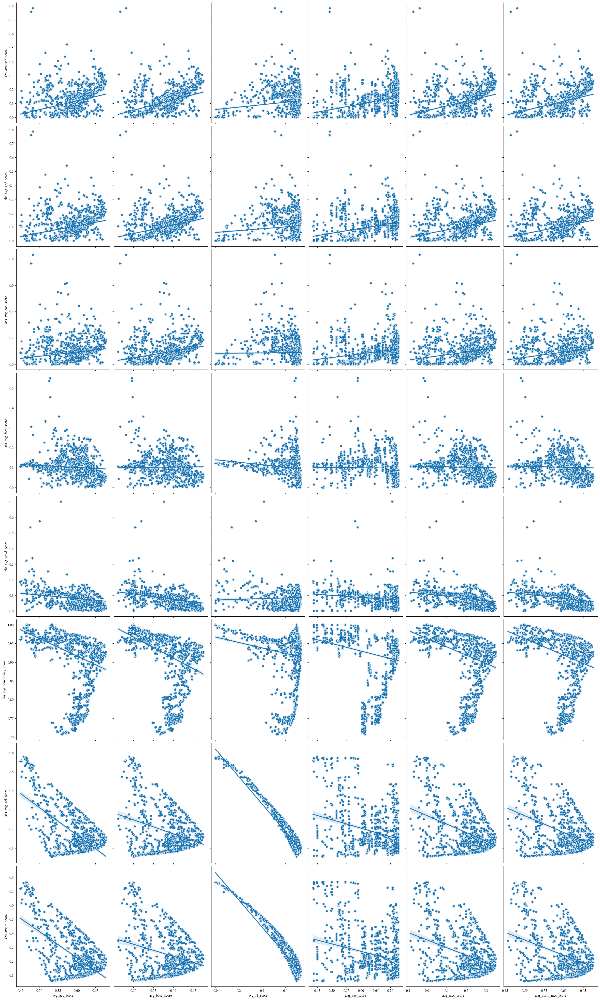

In [37]:
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
g = sns.pairplot(data=results_all_converted, x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

#### 4.1.2 Base_estimator specific Results

We can see from the graphs below:
1. Different base_estimators can also generate very different results: 
    - SVM (red) the least robust, while "NB" manifest clear trend
    - base_estimators divided into two groups when it comes to consistency_score: tree-based, ensemble (trade-offs) vs non tree-based, non ensemble

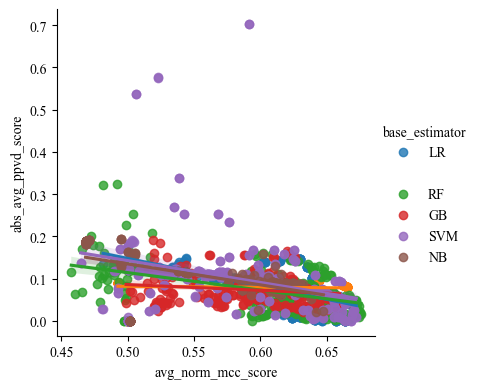

In [126]:
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='base_estimator', height=4)

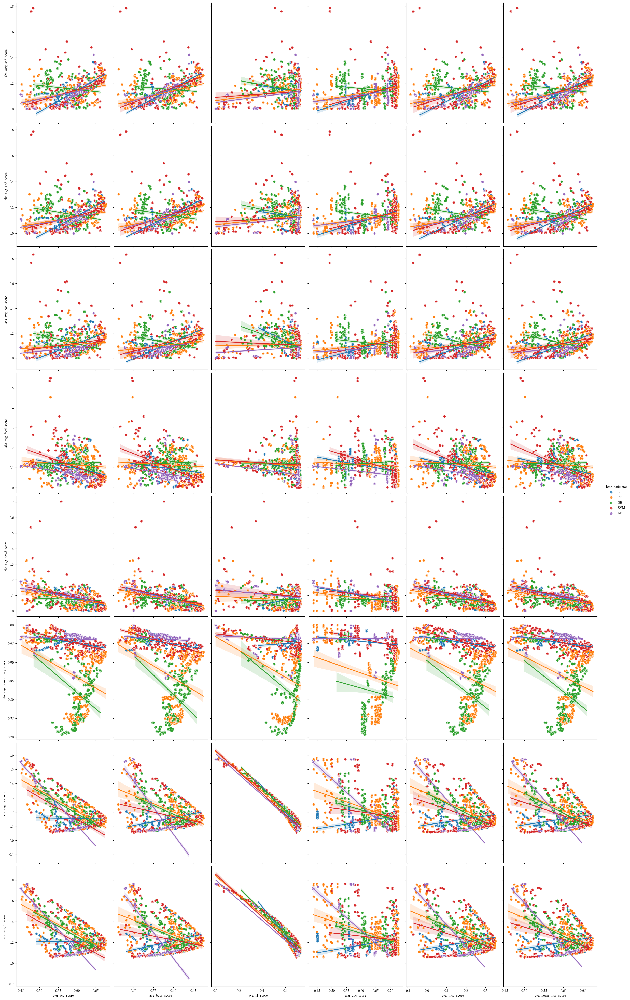

In [38]:
g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator!=''],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='base_estimator')
g.map(sns.scatterplot)

LR


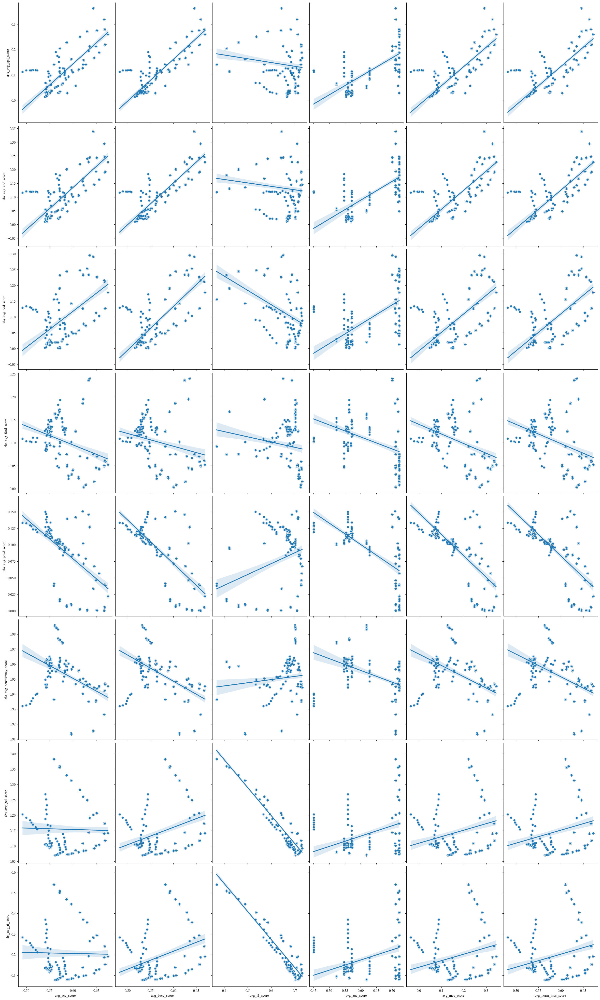


RF


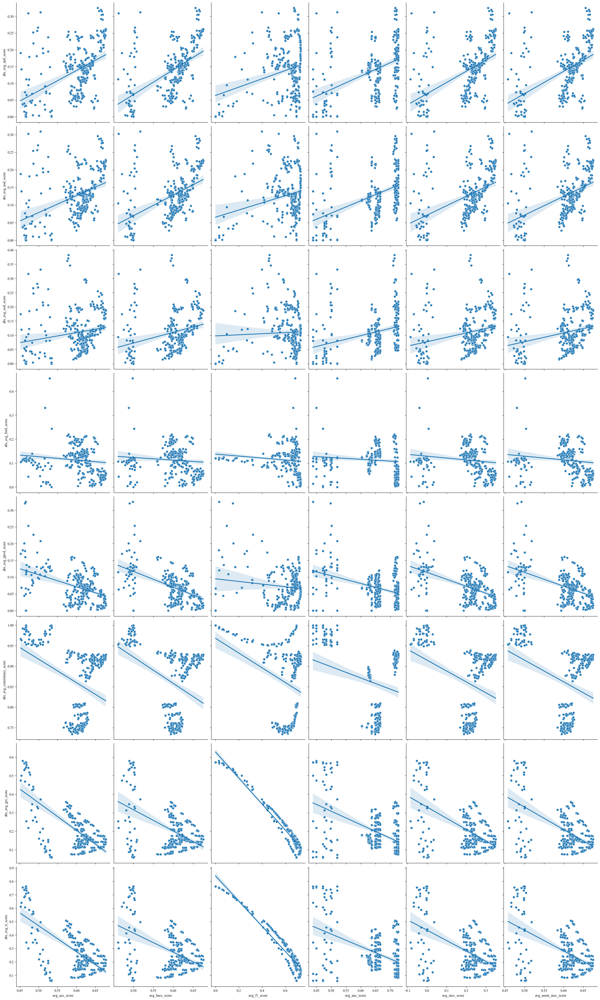

GB


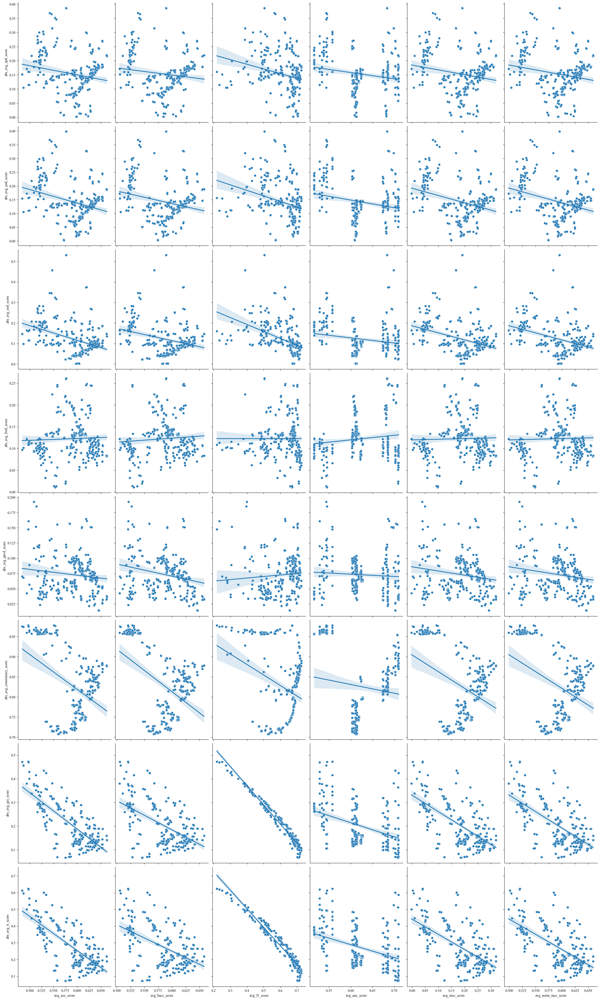

SVM


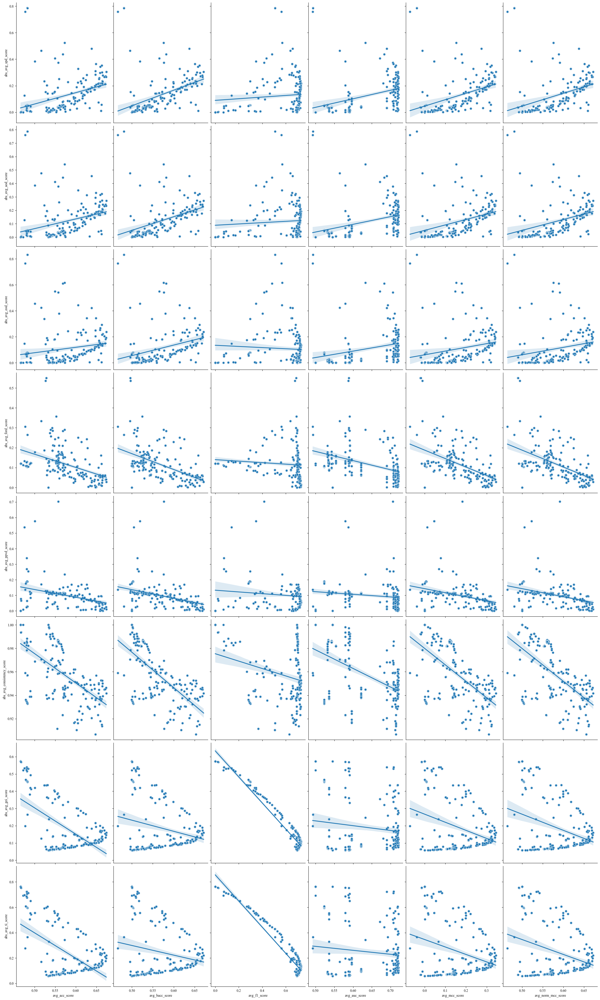

NB


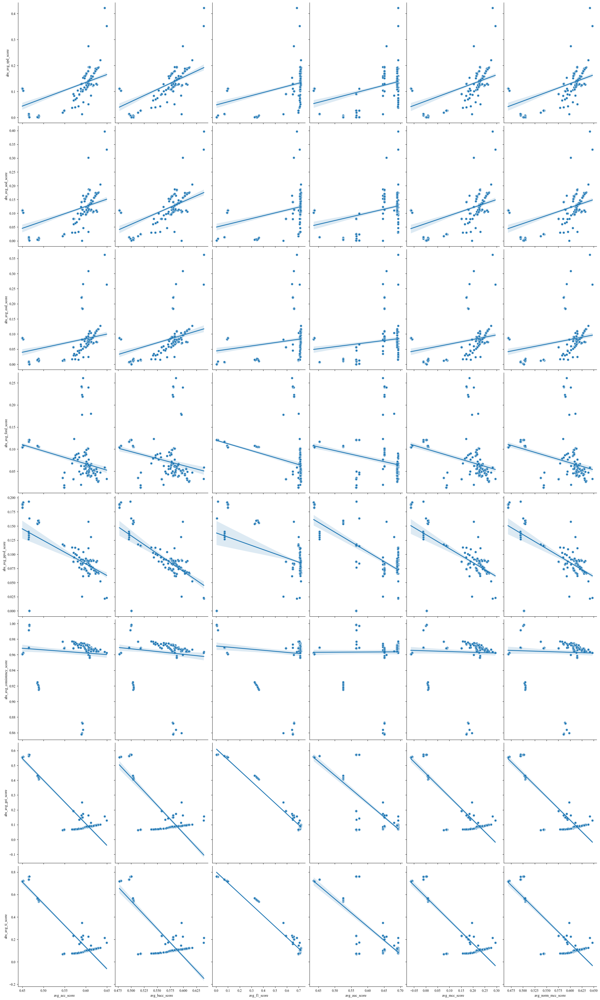

In [39]:
abs_fairness_metrics = ['abs_'+col for col in avg_fairness_metrics]
for base in results_all_converted.base_estimator.unique():
    print(base)
    if base=='':
        pass
    else:
        g = sns.pairplot(data=results_all_converted[results_all_converted.base_estimator==base],
                         x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                         height=5, aspect=.8, kind="reg")
        g.map(sns.scatterplot)
        plt.show()

#### 4.1.3 Threshold specific Results

We can see from the graphs below:
1. Using different threshold also yiels different results: 
    - most obvious with (f1_score, group_fairness) combinations

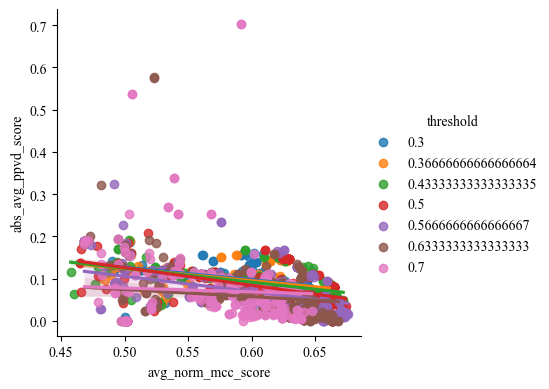

In [127]:
g = sns.lmplot(data=results_all_converted, x=ACC_METRIC, y=FAIR_METRIC, hue='threshold', height=4)

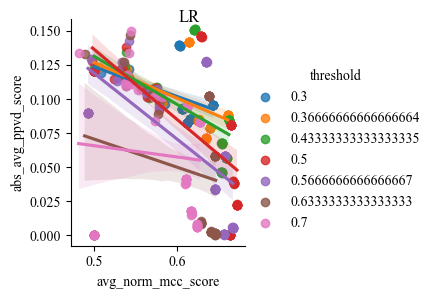

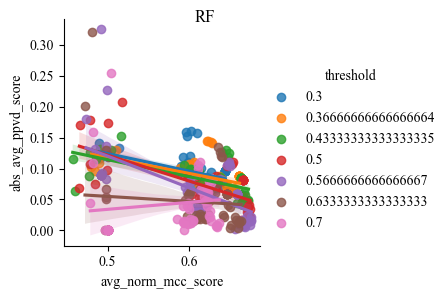

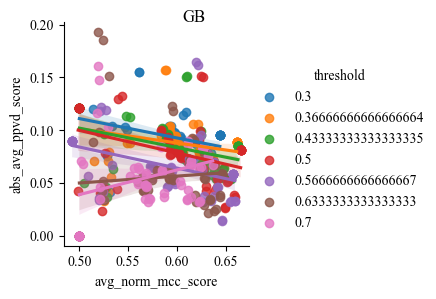

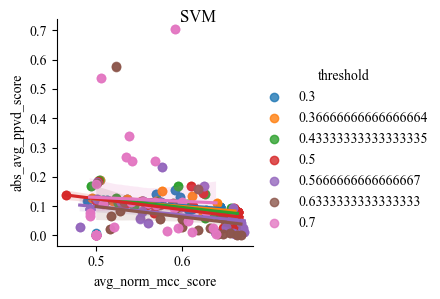

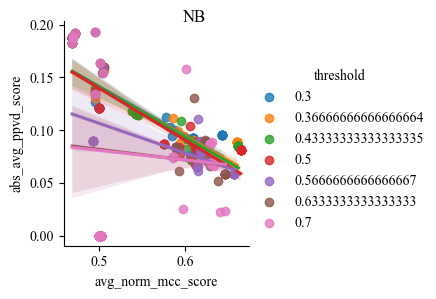

In [130]:
for base in results_all_converted_try.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="threshold", height=3).fig.suptitle(base)

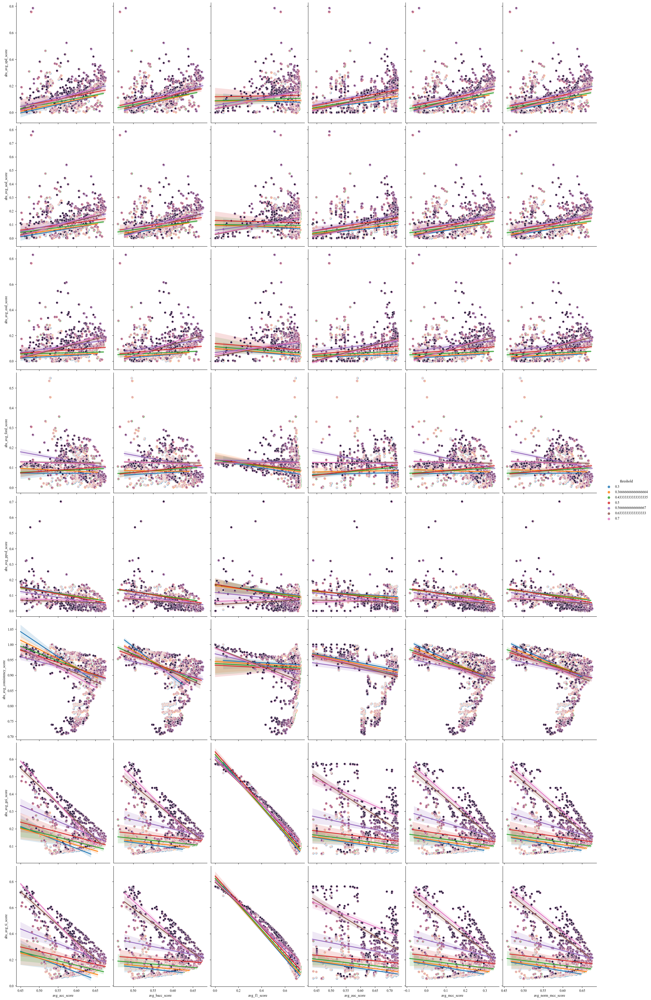

In [40]:
g = sns.pairplot(data=results_all_converted,
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='threshold')
g.map(sns.scatterplot)

#### 4.1.4 Bias_mitigation specific Results

We can see from the graphs below:
1. Results are clearly divided into two groups
2. Generally with wide C.I.

In [41]:
results_all_converted['BM_Category'] = results_all_converted['Bias_Mitigation'].replace({v: k for k, l in bm_category.items()\
                                                                                         for v in l})
results_all_converted[['Bias_Mitigation','BM_Category']].drop_duplicates()

,Bias_Mitigation,BM_Category
0,None,None
7,RW,PRE
14,LFR_pre,PRE
21,LFR_in,IN
28,AD,IN
35,EGR,IN
42,ROC,POST
49,CEO,POST


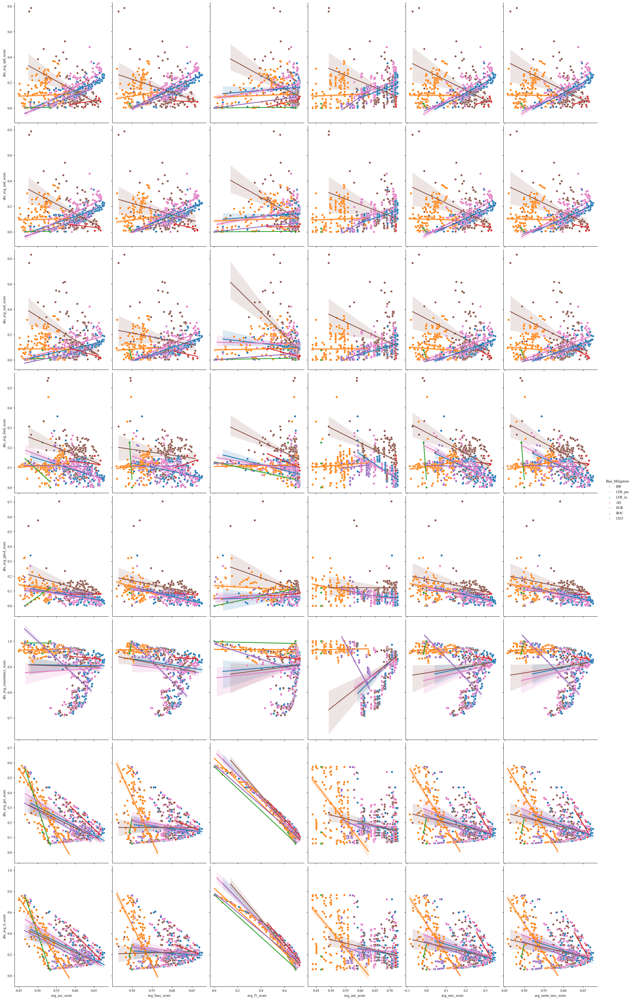

In [42]:
g = sns.pairplot(data=results_all_converted[results_all_converted.BM_Category!='None'],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='Bias_Mitigation', plot_kws={'scatter_kws': {'s': 2}})
g.map(sns.scatterplot)

In [103]:
# results_all_converted_try = results_all_converted.copy(deep=True).reset_index(drop=True)
# for i in results_all_converted_try.index:
#     if results_all_converted_try.loc[i, 'base_estimator'] == '':
#         results_all_converted_try.loc[i, 'base_estimator'] = results_all_converted_try.loc[i-1, 'base_estimator']
        
# results_all_converted_try.reset_index(drop=True).iloc[-30:,]

,base_estimator,param,Bias_Mitigation,threshold,avg_acc_score,avg_bacc_score,avg_f1_score,avg_auc_score,avg_mcc_score,avg_norm_mcc_score,avg_spd_score,avg_aod_score,avg_eod_score,avg_ford_score,avg_ppvd_score,avg_consistency_score,avg_gei_score,avg_ti_score,cost,abs_avg_spd_score,abs_avg_aod_score,abs_avg_eod_score,abs_avg_ford_score,abs_avg_ppvd_score,abs_avg_consistency_score,abs_avg_gei_score,abs_avg_ti_score,BM_Category
2210,NB,,LFR_in,0.633333,0.466179,0.500000,0.000000,0.466842,0.000000,0.500000,0.000000,0.000000,0.000000,-0.120782,0.000000,1.000000,0.572552,0.763187,0.500000,0.000000,0.000000,0.000000,0.120782,0.000000,1.000000,0.572552,0.763187,IN
2211,NB,,LFR_in,0.700000,0.466179,0.500000,0.000000,0.466842,0.000000,0.500000,0.000000,0.000000,0.000000,-0.120782,0.000000,1.000000,0.572552,0.763187,0.500000,0.000000,0.000000,0.000000,0.120782,0.000000,1.000000,0.572552,0.763187,IN
2212,NB,,AD,0.300000,0.630894,0.609429,0.728311,0.721255,0.287915,0.643958,-0.085057,-0.062647,-0.035493,-0.049885,-0.095641,0.928130,0.085330,0.098984,0.270986,0.085057,0.062647,0.035493,0.049885,0.095641,0.928130,0.085330,0.098984,IN
2213,NB,,AD,0.366667,0.656423,0.640392,0.731660,0.721255,0.322460,0.661230,-0.091010,-0.061196,-0.033434,-0.085075,-0.088371,0.933171,0.101389,0.125032,0.247760,0.091010,0.061196,0.033434,0.085075,0.088371,0.933171,0.101389,0.125032,IN
2214,NB,,AD,0.433333,0.663415,0.652425,0.720859,0.721255,0.325066,0.662533,-0.076637,-0.043394,-0.015337,-0.115161,-0.084527,0.931220,0.122393,0.159317,0.260830,0.076637,0.043394,0.015337,0.115161,0.084527,0.931220,0.122393,0.159317,IN
2215,NB,,AD,0.500000,0.667480,0.663704,0.697472,0.721255,0.330600,0.665300,-0.049314,-0.012396,0.013800,-0.134956,-0.081221,0.926407,0.155460,0.212852,0.285386,0.049314,0.012396,0.013800,0.134956,0.081221,0.926407,0.155460,0.212852,IN
2216,NB,,AD,0.566667,0.652358,0.656879,0.643500,0.721255,0.315754,0.657877,-0.024508,0.009184,0.052668,-0.158554,-0.058553,0.936976,0.205459,0.290851,0.317615,0.024508,0.009184,0.052668,0.158554,0.058553,0.936976,0.205459,0.290851,IN
2217,NB,,AD,0.633333,0.626341,0.638227,0.568499,0.721255,0.292917,0.646458,0.010389,0.039145,0.083744,-0.159381,-0.058081,0.939089,0.260890,0.373838,0.363930,0.010389,0.039145,0.083744,0.159381,0.058081,0.939089,0.260890,0.373838,IN
2218,NB,,AD,0.700000,0.586829,0.606092,0.453034,0.721255,0.254435,0.627217,0.030890,0.053423,0.083708,-0.144930,-0.083149,0.941301,0.333729,0.475745,0.403673,0.030890,0.053423,0.083708,0.144930,0.083149,0.941301,0.333729,0.475745,IN
2219,NB,{'var_smoothing': 1e-09},EGR,0.300000,0.548780,0.517905,0.697500,0.564991,0.086786,0.543393,-0.027174,-0.024414,-0.014827,-0.013259,-0.115205,0.968260,0.066953,0.072590,0.429433,0.027174,0.024414,0.014827,0.013259,0.115205,0.968260,0.066953,0.072590,IN


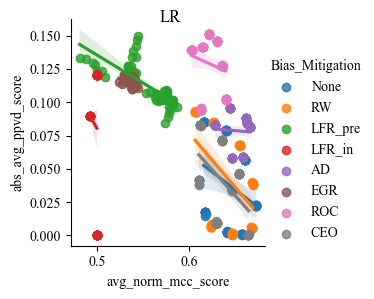

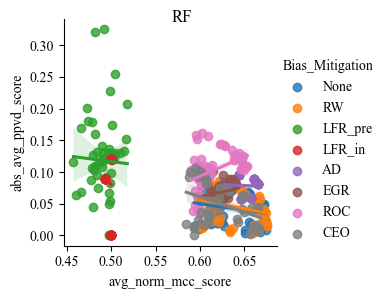

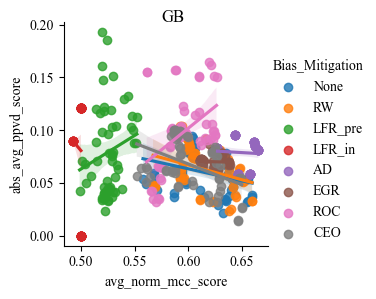

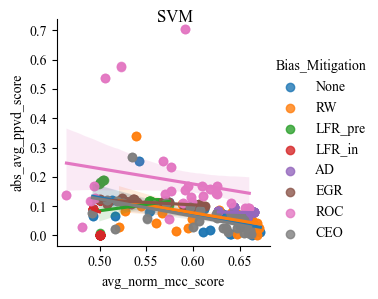

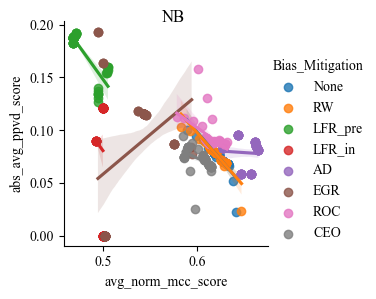

In [116]:
for base in results_all_converted_try.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted_try[results_all_converted_try.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="Bias_Mitigation", height=3).fig.suptitle(base)

##### Bias Mitigation Category

Pre- and post-processing always generate similar results, while in-processing is usually different:
    - less trade-offs between group fairness and accuracy
    - but trade-offs for "ford_score", which is the very g_fair metric showing no trade-offs in overall results

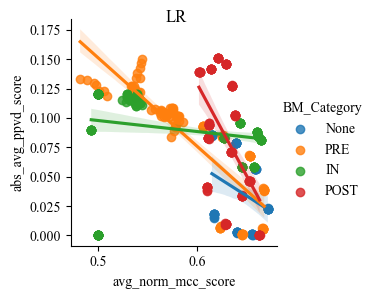

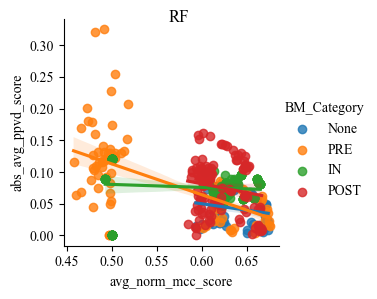

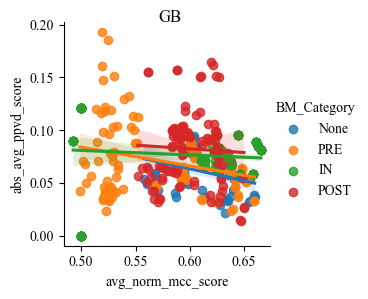

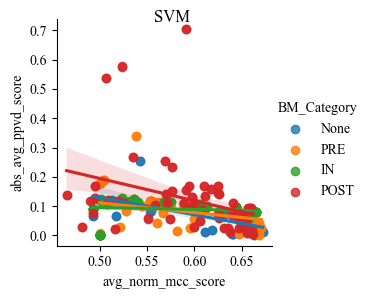

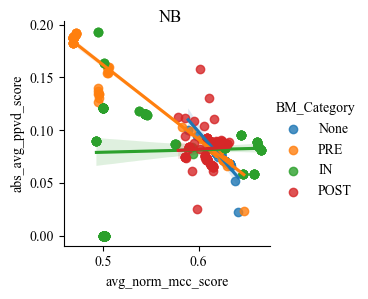

In [115]:
for base in results_all_converted_try.base_estimator.unique():
    g = sns.lmplot(data=results_all_converted[results_all_converted.base_estimator==base],
                   x="avg_norm_mcc_score", y="abs_avg_ppvd_score", hue="BM_Category", height=3).fig.suptitle(base)

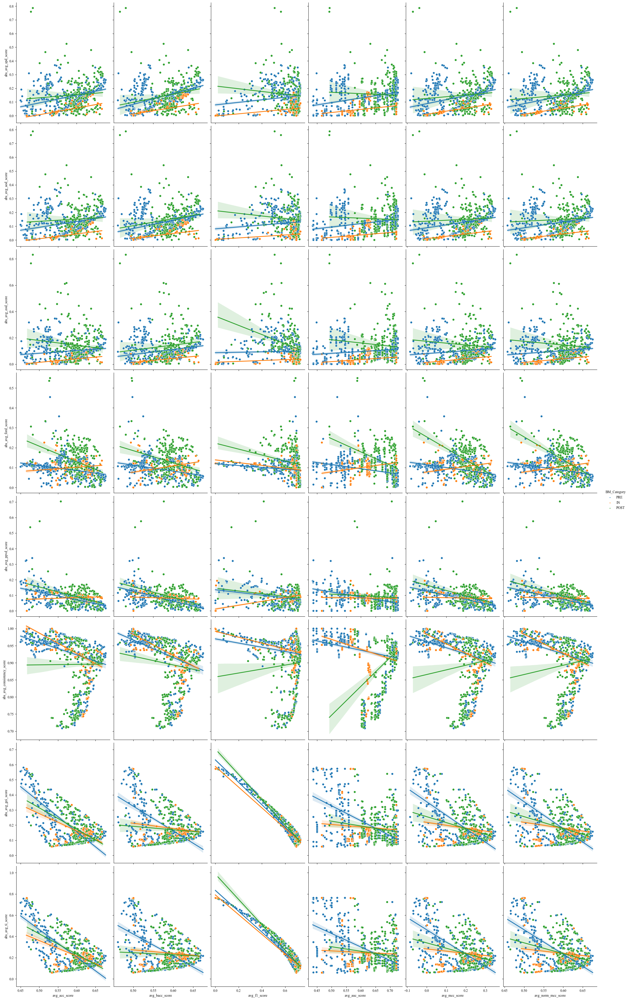

In [45]:
g = sns.pairplot(data=results_all_converted[results_all_converted.BM_Category!='None'],
                 x_vars=avg_accuracy_metrics, y_vars=abs_fairness_metrics,
                 height=5, aspect=.8, kind="reg", hue='BM_Category', plot_kws={'scatter_kws': {'s': 2}})
g.map(sns.scatterplot)

### 4.2 Group vs. Individual Fairness

No clear trend between group and individual fairness with a few exceptions

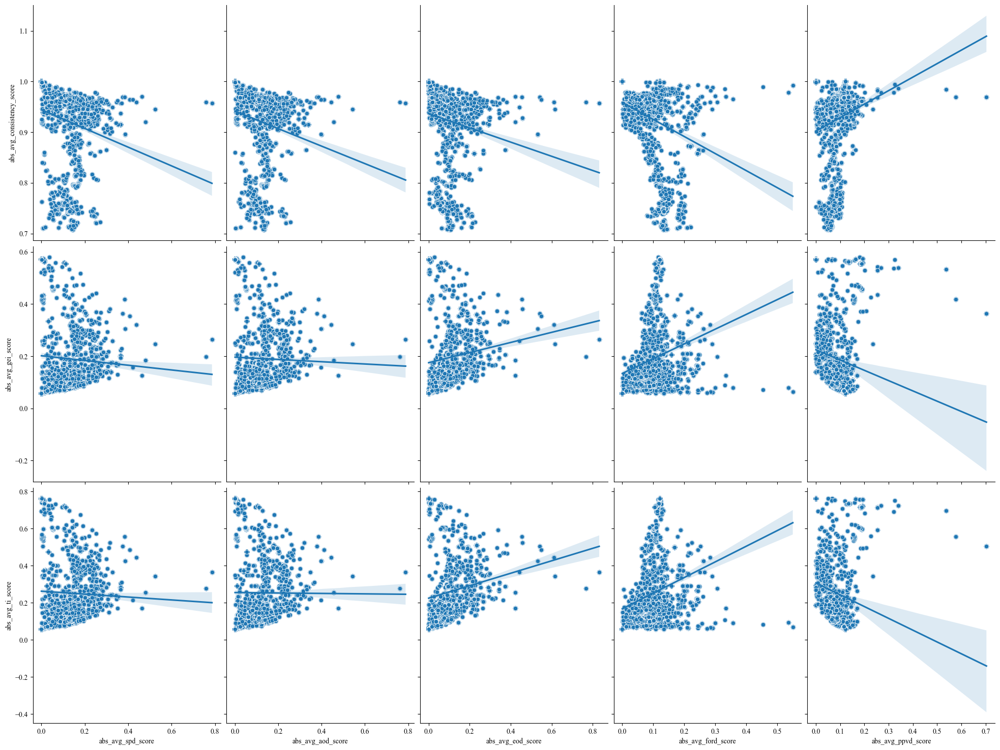

In [46]:
g = sns.pairplot(data=results_all_converted,
                 x_vars=['abs_avg_'+col for col in group_fairness], y_vars=['abs_avg_'+col for col in individual_fairness],
             height=5, aspect=.8, kind="reg")
g.map(sns.scatterplot)

#### 4.2.1 Heatmap

<AxesSubplot:>

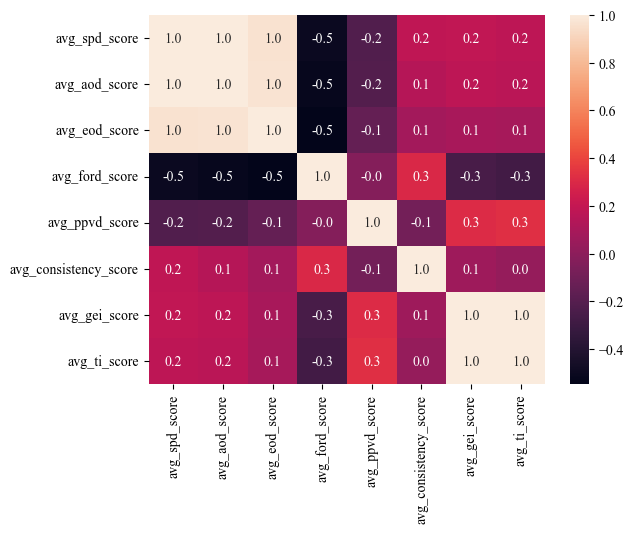

In [47]:
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_fairness_metrics].corr(), annot=True, fmt=".1f")

<AxesSubplot:>

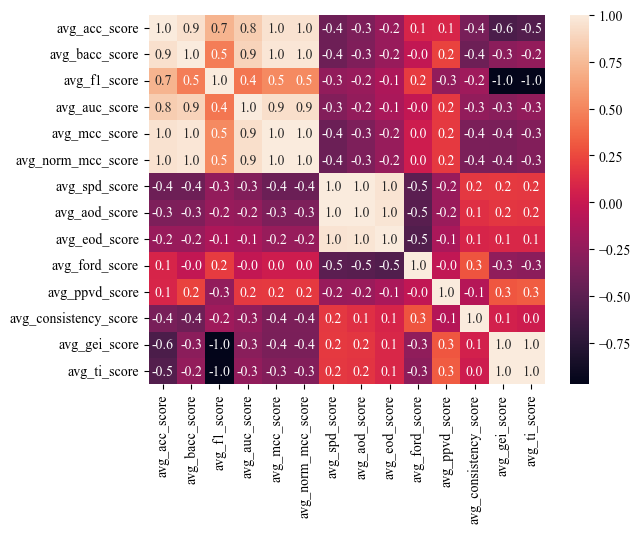

In [48]:
# avg_accuracy_metrics = ['avg_'+col for col in accuracy_metrics]
# avg_fairness_metrics = ['avg_'+col for col in fairness_metrics]
sns.heatmap(results_all_converted[avg_accuracy_metrics+avg_fairness_metrics].corr(), annot=True, fmt=".1f")